<a href="https://colab.research.google.com/github/Itssubhasish/GAN-MNIST/blob/main/Shape_of_Art_In_machine's_eye.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##***Prior works***

---



*   Loading and preprocessing data
*   Augmenting the data to feed into the network
*   Using base model as Resnet variates and training
*   Testing performance on random images






#Import Libraries

In [177]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import json
import os
from tqdm import tqdm, tqdm_notebook
import random
import warnings
warnings.filterwarnings(action = 'ignore')
import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.applications import *
from tensorflow.keras.callbacks import *
from tensorflow.keras.initializers import *
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from numpy.random import seed


#Loading Dataset

In [178]:
artists = pd.read_csv('/content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data/artists.csv')
artists.head()

,id,name,years,genre,nationality,bio,wikipedia,paintings
0,0,Amedeo Modigliani,1884 - 1920,Expressionism,Italian,Amedeo Clemente Modigliani (Italian pronunciat...,http://en.wikipedia.org/wiki/Amedeo_Modigliani,193
1,1,Vasiliy Kandinskiy,1866 - 1944,"Expressionism,Abstractionism",Russian,Wassily Wassilyevich Kandinsky (Russian: Васи́...,http://en.wikipedia.org/wiki/Wassily_Kandinsky,88
2,2,Diego Rivera,1886 - 1957,"Social Realism,Muralism",Mexican,Diego María de la Concepción Juan Nepomuceno E...,http://en.wikipedia.org/wiki/Diego_Rivera,70
3,3,Claude Monet,1840 - 1926,Impressionism,French,Oscar-Claude Monet (; French: [klod mɔnɛ]; 14 ...,http://en.wikipedia.org/wiki/Claude_Monet,73
4,4,Rene Magritte,1898 - 1967,"Surrealism,Impressionism",Belgian,René François Ghislain Magritte (French: [ʁəne...,http://en.wikipedia.org/wiki/René_Magritte,194


#We'll select the classes haveing more than 200 paintings

In [179]:
# Sort artists by number of paintings
artists = artists.sort_values(by=['paintings'], ascending=False)

# Create a dataframe with artists having more than 200 paintings
artists_top = artists[artists['paintings'] >= 200].reset_index()
artists_top = artists_top[['name', 'paintings']]
#artists_top['class_weight'] = max(artists_top.paintings)/artists_top.paintings
artists_top['class_weight'] = artists_top.paintings.sum() / (artists_top.shape[0] * artists_top.paintings)

# There is some problem recognizing 'Albrecht_Dürer' (don't know why, worth exploring)
# So I'll update this string as directory name to artists's
updated_name = "Albrecht_Dürer".replace("ü", "u")
artists_top.iloc[4, 0] = updated_name

In [180]:
# Set class weights - assign higher weights to underrepresented classes
class_weights = artists_top['class_weight'].to_dict()
class_weights

{0: 0.44563076604125634,
 1: 0.5567210567210568,
 2: 0.8902464278318493,
 3: 1.1631493506493507,
 4: 1.1915188470066518,
 5: 1.2566501023092662,
 6: 1.3430178069353327,
 7: 1.491672449687717,
 8: 1.5089505089505089,
 9: 1.532620320855615,
 10: 1.6352225180677062}

# To see if all directories exists or not

In [ ]:
# Explore images of top artists
images_dir = '/content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data/images/images'
artists_dirs = os.listdir(images_dir)
artists_top_name = artists_top['name'].str.replace(' ', '_').values

# See if all directories exist
for name in artists_top_name:
    if os.path.exists(os.path.join(images_dir, name)):
        print("Found -->", os.path.join(images_dir, name))
    else:
        print("Did not find -->", os.path.join(images_dir, name))

Found --> /content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data/images/images/Vincent_van_Gogh
Found --> /content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data/images/images/Edgar_Degas
Found --> /content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data/images/images/Pablo_Picasso
Found --> /content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data/images/images/Pierre-Auguste_Renoir
Found --> /content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data/images/images/Albrecht_Durer
Found --> /content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data/images/images/Paul_Gauguin
Found --> /content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data/images/images/Francisco_Goya
Found --> /content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data/images/images/Rembrandt
Found --> /content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data/images/images/Alfred_Sisley
Found --> /content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data/images/images/Titian
Found --> /content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data/images/images/Marc_Chagall


#Data Augmentation

In [ ]:
# Augment data
batch_size = 16
train_input_shape = (224, 224, 3)
n_classes = artists_top.shape[0]

train_datagen = ImageDataGenerator(validation_split=0.2,
                                   rescale=1./255.,
                                   #rotation_range=45,
                                   #width_shift_range=0.5,
                                   #height_shift_range=0.5,
                                   shear_range=5,
                                   #zoom_range=0.7,
                                   horizontal_flip=True,
                                   vertical_flip=True,
                                  )

train_generator = train_datagen.flow_from_directory(directory=images_dir,
                                                    class_mode='categorical',
                                                    target_size=train_input_shape[0:2],
                                                    batch_size=batch_size,
                                                    subset="training",
                                                    shuffle=True,
                                                    classes=artists_top_name.tolist()
                                                   )

valid_generator = train_datagen.flow_from_directory(directory=images_dir,
                                                    class_mode='categorical',
                                                    target_size=train_input_shape[0:2],
                                                    batch_size=batch_size,
                                                    subset="validation",
                                                    shuffle=True,
                                                    classes=artists_top_name.tolist()
                                                   )

STEP_SIZE_TRAIN = train_generator.n//train_generator.batch_size
STEP_SIZE_VALID = valid_generator.n//valid_generator.batch_size
print("Total number of batches =", STEP_SIZE_TRAIN, "and", STEP_SIZE_VALID)

Found 3456 images belonging to 11 classes.
Found 858 images belonging to 11 classes.
Total number of batches = 216 and 53


(-0.5, 451.5, 599.5, -0.5)

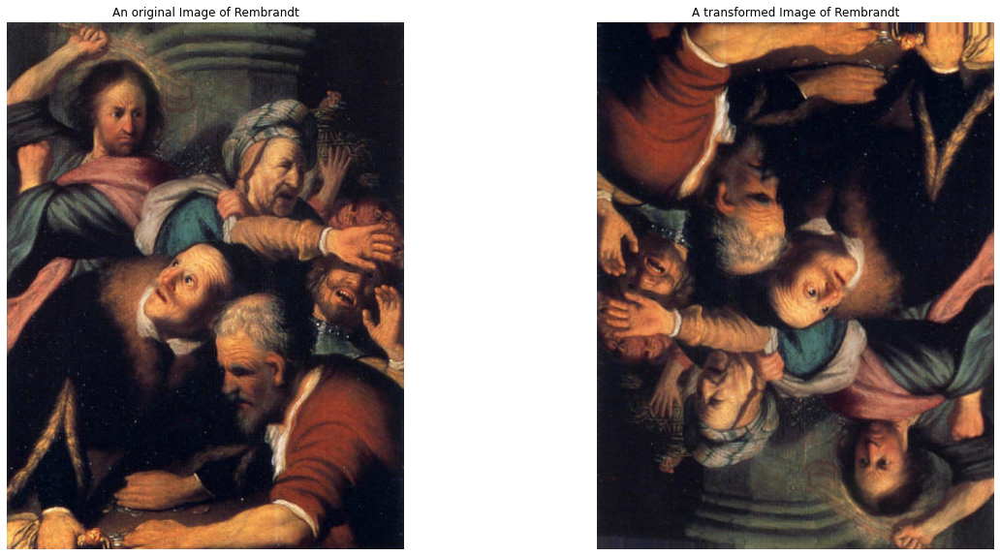

In [ ]:
# Print a random paintings and it's random augmented version
fig, axes = plt.subplots(1, 2, figsize=(20,10))

random_artist = random.choice(artists_top_name)
random_image = random.choice(os.listdir(os.path.join(images_dir, random_artist)))
random_image_file = os.path.join(images_dir, random_artist, random_image)

# Original image
image = plt.imread(random_image_file)
axes[0].imshow(image)
axes[0].set_title("An original Image of " + random_artist.replace('_', ' '))
axes[0].axis('off')

# Transformed image
aug_image = train_datagen.random_transform(image)
axes[1].imshow(aug_image)
axes[1].set_title("A transformed Image of " + random_artist.replace('_', ' '))
axes[1].axis('off')

# Loading base model

In [ ]:
# Load pre-trained model
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=train_input_shape)

for layer in base_model.layers:
    layer.trainable = True

94773248/94765736 [==============================] - 1s 0us/step


# Add layers at the end


In [ ]:
X = base_model.output
X = Flatten()(X)

X = Dense(512, kernel_initializer='he_uniform')(X)
#X = Dropout(0.5)(X)
X = BatchNormalization()(X)
X = Activation('relu')(X)

X = Dense(16, kernel_initializer='he_uniform')(X)
#X = Dropout(0.5)(X)
X = BatchNormalization()(X)
X = Activation('relu')(X)

output = Dense(n_classes, activation='softmax')(X)

model = Model(inputs=base_model.input, outputs=output)

In [ ]:

optimizer = Adam(lr=0.0001)
model.compile(loss='categorical_crossentropy',
              optimizer=optimizer, 
              metrics=['accuracy'])

In [ ]:


n_epoch = 10

early_stop = EarlyStopping(monitor='val_loss', patience=20, verbose=1, 
                           mode='auto', restore_best_weights=True)

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, 
                              verbose=1, mode='auto')

# Train the model - all layers


In [ ]:
history1 = model.fit_generator(generator=train_generator, steps_per_epoch=STEP_SIZE_TRAIN,
                              validation_data=valid_generator, validation_steps=STEP_SIZE_VALID,
                              epochs=n_epoch,
                              shuffle=True,
                              verbose=1,
                              callbacks=[reduce_lr],
                              use_multiprocessing=True,
                              workers=16,
                              class_weight=class_weights
                             )

Epoch 1/10
216/216 [==============================] - 295s 1s/step - loss: 1.7583 - accuracy: 0.4342 - val_loss: 2.6655 - val_accuracy: 0.0672
Epoch 2/10
216/216 [==============================] - 116s 512ms/step - loss: 1.1320 - accuracy: 0.7467 - val_loss: 2.4084 - val_accuracy: 0.1061
Epoch 3/10
216/216 [==============================] - 116s 516ms/step - loss: 0.9687 - accuracy: 0.8005 - val_loss: 2.3775 - val_accuracy: 0.1380
Epoch 4/10
216/216 [==============================] - 118s 520ms/step - loss: 0.8480 - accuracy: 0.8463 - val_loss: 2.3950 - val_accuracy: 0.2193
Epoch 5/10
216/216 [==============================] - 116s 517ms/step - loss: 0.7187 - accuracy: 0.8798 - val_loss: 1.3312 - val_accuracy: 0.5873
Epoch 6/10
216/216 [==============================] - 117s 517ms/step - loss: 0.6458 - accuracy: 0.8904 - val_loss: 0.9346 - val_accuracy: 0.7818
Epoch 7/10
216/216 [==============================] - 117s 516ms/step - loss: 0.6068 - accuracy: 0.8940 - val_loss: 0.9293 - va

In [ ]:
# Freeze core ResNet layers and train again 
for layer in model.layers:
    layer.trainable = False

for layer in model.layers[:50]:
    layer.trainable = True

optimizer = Adam(lr=0.0001)

model.compile(loss='categorical_crossentropy',
              optimizer=optimizer, 
              metrics=['accuracy'])

n_epoch = 50
history2 = model.fit_generator(generator=train_generator, steps_per_epoch=STEP_SIZE_TRAIN,
                              validation_data=valid_generator, validation_steps=STEP_SIZE_VALID,
                              epochs=n_epoch,
                              shuffle=True,
                              verbose=1,
                              callbacks=[reduce_lr, early_stop],
                              use_multiprocessing=True,
                              workers=16,
                              class_weight=class_weights
                             )

Epoch 1/50
216/216 [==============================] - 121s 520ms/step - loss: 0.2451 - accuracy: 0.9730 - val_loss: 0.6945 - val_accuracy: 0.8219
Epoch 2/50
216/216 [==============================] - 115s 511ms/step - loss: 0.2024 - accuracy: 0.9794 - val_loss: 0.6613 - val_accuracy: 0.8278
Epoch 3/50
216/216 [==============================] - 116s 514ms/step - loss: 0.1791 - accuracy: 0.9831 - val_loss: 0.6237 - val_accuracy: 0.8561
Epoch 4/50
216/216 [==============================] - 115s 509ms/step - loss: 0.1700 - accuracy: 0.9834 - val_loss: 0.6024 - val_accuracy: 0.8443
Epoch 5/50
216/216 [==============================] - 115s 509ms/step - loss: 0.1647 - accuracy: 0.9847 - val_loss: 0.5899 - val_accuracy: 0.8491
Epoch 6/50
216/216 [==============================] - 115s 508ms/step - loss: 0.1547 - accuracy: 0.9840 - val_loss: 0.5839 - val_accuracy: 0.8408
Epoch 7/50
216/216 [==============================] - 116s 515ms/step - loss: 0.1401 - accuracy: 0.9851 - val_loss: 0.6487 -

## Merge history1 and history2


In [ ]:
history = {}
history['loss'] = history1.history['loss'] + history2.history['loss']
history['accuracy'] = history1.history['accuracy'] + history2.history['accuracy']
history['val_loss'] = history1.history['val_loss'] + history2.history['val_loss']
history['val_accuracy'] = history1.history['val_accuracy'] + history2.history['val_accuracy']
history['lr'] = history1.history['lr'] + history2.history['lr']

# Plot the training graph


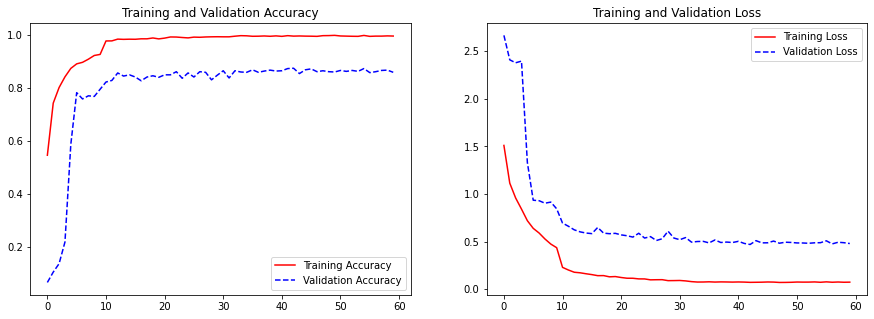

In [ ]:
def plot_training(history):
    acc = history['accuracy']
    val_acc = history['val_accuracy']
    loss = history['loss']
    val_loss = history['val_loss']
    epochs = range(len(acc))

    fig, axes = plt.subplots(1, 2, figsize=(15,5))
    
    axes[0].plot(epochs, acc, 'r-', label='Training Accuracy')
    axes[0].plot(epochs, val_acc, 'b--', label='Validation Accuracy')
    axes[0].set_title('Training and Validation Accuracy')
    axes[0].legend(loc='best')

    axes[1].plot(epochs, loss, 'r-', label='Training Loss')
    axes[1].plot(epochs, val_loss, 'b--', label='Validation Loss')
    axes[1].set_title('Training and Validation Loss')
    axes[1].legend(loc='best')
    
    plt.show()
    
plot_training(history)


In [ ]:
# Prediction accuracy on train data
score = model.evaluate_generator(train_generator, verbose=1)
print("Prediction accuracy on train data =", score[1])


Instructions for updating:
Please use Model.evaluate, which supports generators.
216/216 [==============================] - 97s 448ms/step - loss: 0.0955 - accuracy: 0.9968
Prediction accuracy on train data = 0.9968171119689941


In [ ]:
# Prediction accuracy on CV data
score = model.evaluate_generator(valid_generator, verbose=1)
print("Prediction accuracy on CV data =", score[1])

54/54 [==============================] - 23s 433ms/step - loss: 0.5043 - accuracy: 0.8625
Prediction accuracy on CV data = 0.8624708652496338


# Classification report and confusion matrix


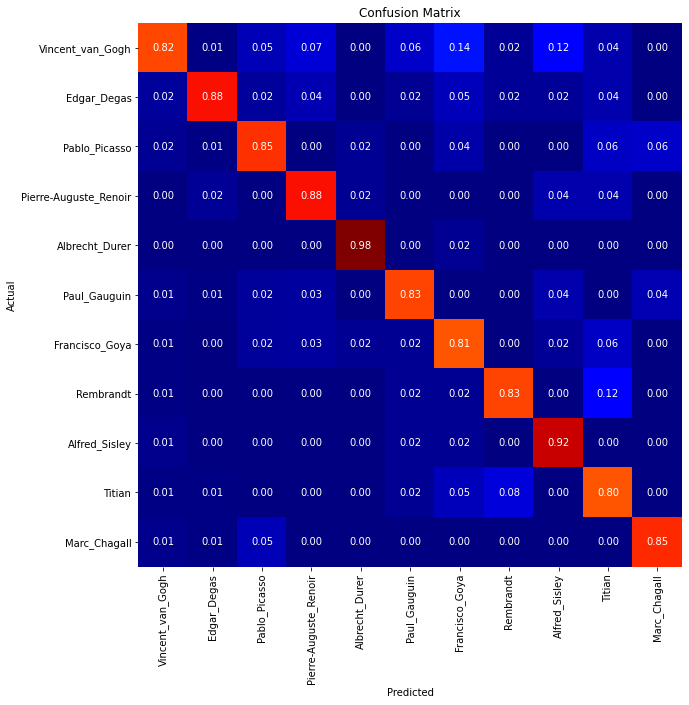

Classification Report:
                       precision    recall  f1-score   support

     Vincent_van_Gogh       0.90      0.82      0.86       172
          Edgar_Degas       0.94      0.88      0.91       139
        Pablo_Picasso       0.84      0.85      0.84        84
Pierre-Auguste_Renoir       0.83      0.88      0.86        67
       Albrecht_Durer       0.96      0.98      0.97        65
         Paul_Gauguin       0.85      0.83      0.84        63
       Francisco_Goya       0.71      0.81      0.75        57
            Rembrandt       0.88      0.83      0.85        52
        Alfred_Sisley       0.80      0.92      0.85        51
               Titian       0.69      0.80      0.75        51
         Marc_Chagall       0.89      0.85      0.87        47

             accuracy                           0.86       848
            macro avg       0.84      0.86      0.85       848
         weighted avg       0.86      0.86      0.86       848



In [ ]:
from sklearn.metrics import *
import seaborn as sns

tick_labels = artists_top_name.tolist()

def showClassficationReport_Generator(model, valid_generator, STEP_SIZE_VALID):
    # Loop on each generator batch and predict
    y_pred, y_true = [], []
    for i in range(STEP_SIZE_VALID):
        (X,y) = next(valid_generator)
        y_pred.append(model.predict(X))
        y_true.append(y)
    
    # Create a flat list for y_true and y_pred
    y_pred = [subresult for result in y_pred for subresult in result]
    y_true = [subresult for result in y_true for subresult in result]
    
    # Update Truth vector based on argmax
    y_true = np.argmax(y_true, axis=1)
    y_true = np.asarray(y_true).ravel()
    
    # Update Prediction vector based on argmax
    y_pred = np.argmax(y_pred, axis=1)
    y_pred = np.asarray(y_pred).ravel()
    
    # Confusion Matrix
    fig, ax = plt.subplots(figsize=(10,10))
    conf_matrix = confusion_matrix(y_true, y_pred, labels=np.arange(n_classes))
    conf_matrix = conf_matrix/np.sum(conf_matrix, axis=1)
    sns.heatmap(conf_matrix, annot=True, fmt=".2f", square=True, cbar=False, 
                cmap=plt.cm.jet, xticklabels=tick_labels, yticklabels=tick_labels,
                ax=ax)
    ax.set_ylabel('Actual')
    ax.set_xlabel('Predicted')
    ax.set_title('Confusion Matrix')
    plt.show()
    
    print('Classification Report:')
    print(classification_report(y_true, y_pred, labels=np.arange(n_classes), target_names=artists_top_name.tolist()))

showClassficationReport_Generator(model, valid_generator, STEP_SIZE_VALID)

In [ ]:
random_artist = artists_top_name[1]
random_image = (os.listdir(os.path.join(images_dir, random_artist)))[100:105]
random_artist

'Edgar_Degas'

# Prediction


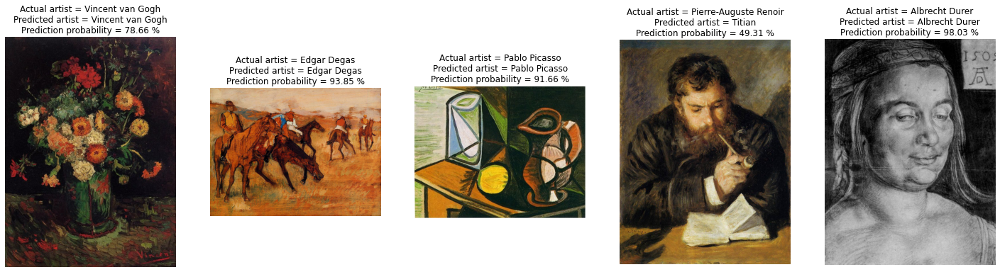

In [ ]:
from keras.preprocessing import *

n = 5
fig, axes = plt.subplots(1, n, figsize=(25,10))

for i in range(n):
    #random_artist = random.choice(artists_top_name)
    random_artist = artists_top_name[i]
    #random_image = random.choice(os.listdir(os.path.join(images_dir, random_artist)))
    random_image = (os.listdir(os.path.join(images_dir, random_artist)))[i]
    random_image_file = os.path.join(images_dir, random_artist, random_image)

    # Original image

    test_image = image.load_img(random_image_file, target_size=(train_input_shape[0:2]))

    # Predict artist
    test_image = image.img_to_array(test_image)
    test_image /= 255.
    test_image = np.expand_dims(test_image, axis=0)

    prediction = model.predict(test_image)
    prediction_probability = np.amax(prediction)
    prediction_idx = np.argmax(prediction)

    labels = train_generator.class_indices
    labels = dict((v,k) for k,v in labels.items())

    #print("Actual artist =", random_artist.replace('_', ' '))
    #print("Predicted artist =", labels[prediction_idx].replace('_', ' '))
    #print("Prediction probability =", prediction_probability*100, "%")

    title = "Actual artist = {}\nPredicted artist = {}\nPrediction probability = {:.2f} %" \
                .format(random_artist.replace('_', ' '), labels[prediction_idx].replace('_', ' '),
                        prediction_probability*100)

    # Print image
    axes[i].imshow(plt.imread(random_image_file))
    axes[i].set_title(title)
    axes[i].axis('off')

plt.show()

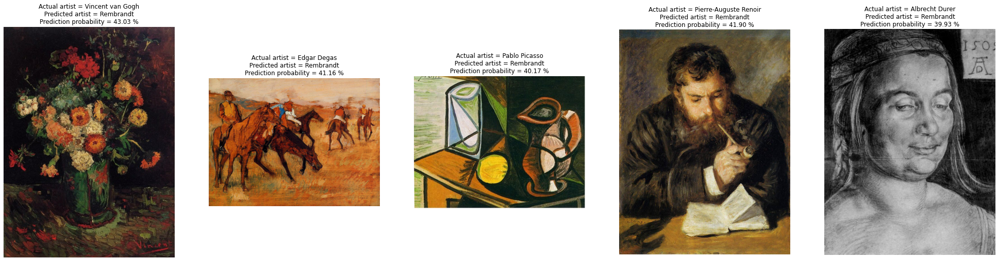

In [ ]:
n = 5
noise_factor=15
fig, axes = plt.subplots(1, n, figsize=(35,10))
for i in range(n):

    #random_artist = random.choice(artists_top_name)
    random_artist = artists_top_name[i]
    #random_image = random.choice(os.listdir(os.path.join(images_dir, random_artist)))
    random_image = (os.listdir(os.path.join(images_dir, random_artist)))[i]
    random_image_file = os.path.join(images_dir, random_artist, random_image)

    # Original image with added noise
    test_image = image.load_img(random_image_file, target_size=(train_input_shape[0:2]))

    test_image_noise_1=test_image + noise_factor*np.random.normal(loc=0.0,scale=5.0,size=(test_image.width,test_image.height,3))
    test_image_noise_1=np.clip(test_image_noise_1,0.,1.)
    
    
    test_image_noise = image.img_to_array(test_image_noise_1)
    test_image_noise /= 255.
    test_image_noise = np.expand_dims(test_image_noise, axis=0)

    prediction = model.predict(test_image_noise)
    prediction_probability = np.amax(prediction)
    prediction_idx = np.argmax(prediction)

    labels = train_generator.class_indices
    labels = dict((v,k) for k,v in labels.items())

    title = "Actual artist = {}\nPredicted artist = {}\nPrediction probability = {:.2f} %"                 .format(random_artist.replace('_', ' '), labels[prediction_idx].replace('_', ' '),
                        prediction_probability*100)

    # Print image
    axes[i].imshow(plt.imread(random_image_file))
    #axes[i].imshow(test_image_noise_1)
    axes[i].set_title(title)
    axes[i].axis('off')

plt.show()

#Extenion of the project


---



## 1.  Art restoration:
 Here, we will be adding many type of *noises, black/white patches, lines squares, etc* to make the image distorted. And, then we will try different neural network model to identify the error and remove them to restore the original like image.


> Basically, we will be adding Gaussian noise, salt & pepper noise, impulse noise, pink noise, white line(having width of atleast 10px), white/black square etc.







*   **Autoencoder**, the first name occurs when it comes to the work of image denoising.
*   Will try also some combination CNN blocks to remove the patches and errors



---


## 2. Deep learning style transfer:
Style transfer is the technique of reconstructing images in the style of another image.
There are varoius research papers on this topic that how neural networks could be used to generate artistic style images, each author stating their own innovative way of optimization and loss function to create a artistic image generating neural network.


> We will be using VGG19, ResNets for this kind of work




# First let's visualise some images

In [5]:
from keras.preprocessing.image import load_img, save_img, img_to_array
from keras.models import Model,Sequential
import os
import matplotlib.pyplot as plt
import numpy as np
import warnings
warnings.filterwarnings("ignore")
import seaborn as sns
from tensorflow import keras
#from keras.layers import Input,Conv2D,MaxPooling2D,UpSampling2D,Dense,Dropout,Flatten, Conv2DTranspose
from keras.layers import *
print(os.listdir("/content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data"))

['artists.csv', 'images', 'resized', 'artists.gsheet']


In [ ]:
artists.head()

,id,name,years,genre,nationality,bio,wikipedia,paintings
8,8,Vincent van Gogh,1853 – 1890,Post-Impressionism,Dutch,Vincent Willem van Gogh (Dutch: [ˈvɪnsɛnt ˈʋɪl...,http://en.wikipedia.org/wiki/Vincent_van_Gogh,877
30,30,Edgar Degas,1834 - 1917,Impressionism,French,Edgar Degas (US: or UK: ; born Hilaire-Germai...,http://en.wikipedia.org/wiki/Edgar_Degas,702
13,13,Pablo Picasso,1881 - 1973,Cubism,Spanish,Pablo Ruiz Picasso (; Spanish: [ˈpaβlo piˈkaso...,http://en.wikipedia.org/wiki/Pablo_Picasso,439
15,15,Pierre-Auguste Renoir,1841 - 1919,Impressionism,French,"Pierre-Auguste Renoir, commonly known as Augus...",http://en.wikipedia.org/wiki/Pierre-Auguste_Re...,336
19,19,Albrecht Dürer,1471 - 1528,Northern Renaissance,German,Albrecht Dürer (; German: [ˈʔalbʁɛçt ˈdyːʁɐ]; ...,http://en.wikipedia.org/wiki/Albrecht_Dürer,328


In [6]:
artists_year = pd.DataFrame(artists.years.str.split(' ',2).tolist(),columns = ['birth','-','death'])
artists_year.drop(["-"],axis=1,inplace=True)
artists["birth"]=artists_year.birth
artists["death"]=artists_year.death
artists.drop(["years"],axis=1,inplace=True)
artists["birth"]=artists["birth"].apply(lambda x: int(x))
artists["death"]=artists["death"].apply(lambda x: int(x))
artists["age"]=artists.death-artists.birth
artists['age']=artists['age']
bins=[30,55,65,77,98]
labels=["young adult","early adult","adult","senior"]
artists['age_group']=pd.cut(artists['age'],bins,labels=labels)
artists = artists.sort_values(by=["age"], ascending=False)
artists['rank']=tuple(zip(artists.age))
artists['rank']=artists.groupby('age',sort=False)['rank'].apply(lambda x : pd.Series(pd.factorize(x)[0])).values
artists.drop(["rank"],axis=1,inplace=True)
artists.reset_index(inplace=True,drop=True)
artists.head()

,id,name,genre,nationality,bio,wikipedia,paintings,birth,death,age,age_group
0,10,Hieronymus Bosch,Northern Renaissance,Dutch,Hieronymus Bosch ( (listen); Dutch: [ɦijeːˈroː...,http://en.wikipedia.org/wiki/Hieronymus_Bosch,137,1887,1985,98,senior
1,2,Diego Rivera,"Social Realism,Muralism",Mexican,Diego María de la Concepción Juan Nepomuceno E...,http://en.wikipedia.org/wiki/Diego_Rivera,70,1881,1973,92,senior
2,29,Jan van Eyck,Northern Renaissance,Flemish,Jan van Eyck (Dutch: [ˈjɑn vɑn ˈɛik]) (before ...,http://en.wikipedia.org/wiki/Jan_van_Eyck,81,1893,1983,90,senior
3,45,Andy Warhol,Pop Art,American,"Andy Warhol (; born Andrew Warhola; August 6, ...",https://en.wikipedia.org/wiki/Andy_Warhol,181,1475,1564,89,senior
4,9,Gustav Klimt,"Symbolism,Art Nouveau",Austrian,"Gustav Klimt (July 14, 1862 – February 6, 1918...",http://en.wikipedia.org/wiki/Gustav_Klimt,117,1488,1576,88,senior


No handles with labels found to put in legend.


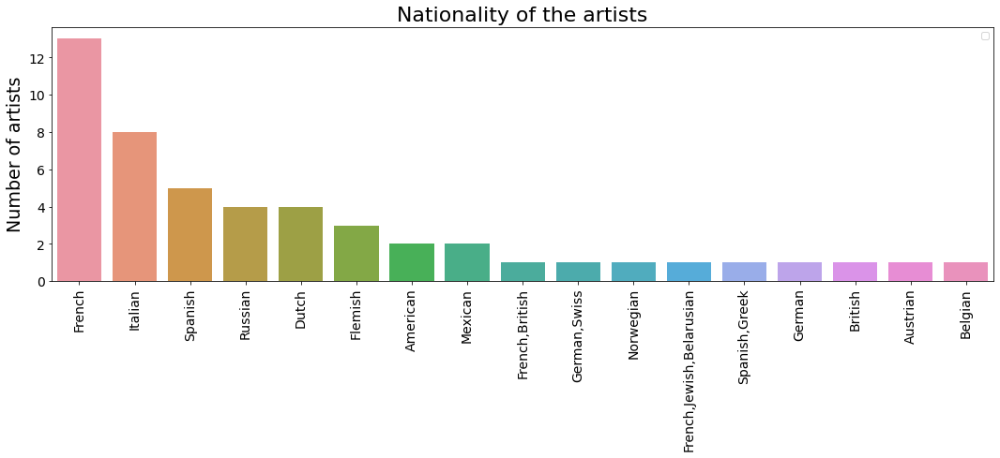

<Figure size 1080x360 with 0 Axes>

In [ ]:
plt.figure(figsize=(18,5))

sns.barplot(x=artists['nationality'].value_counts().index,y=artists['nationality'].value_counts().values)
plt.title('Nationality of the artists')
plt.xticks(rotation=90)
plt.ylabel('Number of artists')
plt.legend(loc=0)
plt.show()
plt.savefig('artists_by_countries.png')

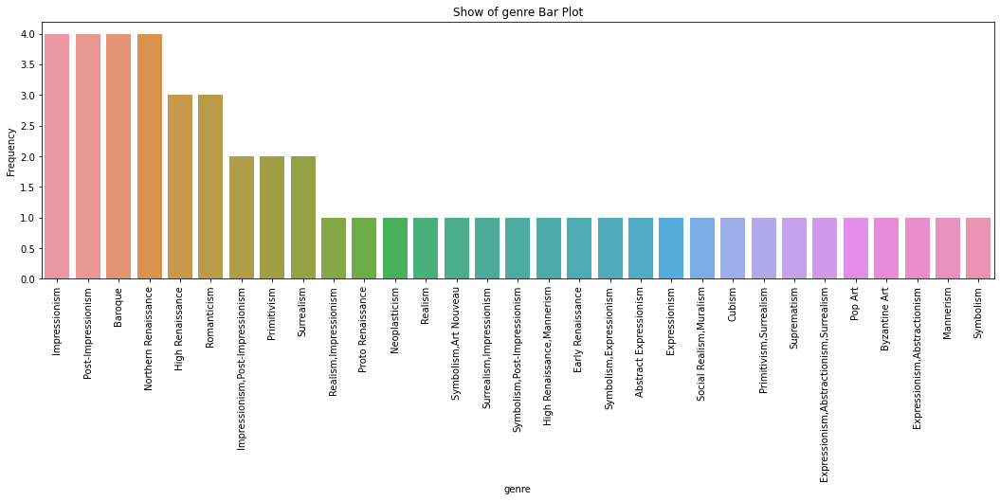

In [ ]:
plt.figure(figsize=(18,5))
sns.barplot(x=artists['genre'].value_counts().index,
              y=artists['genre'].value_counts().values)
plt.xlabel('genre')
plt.xticks(rotation=90)
plt.ylabel('Frequency')
plt.title('Show of genre Bar Plot')
plt.show()

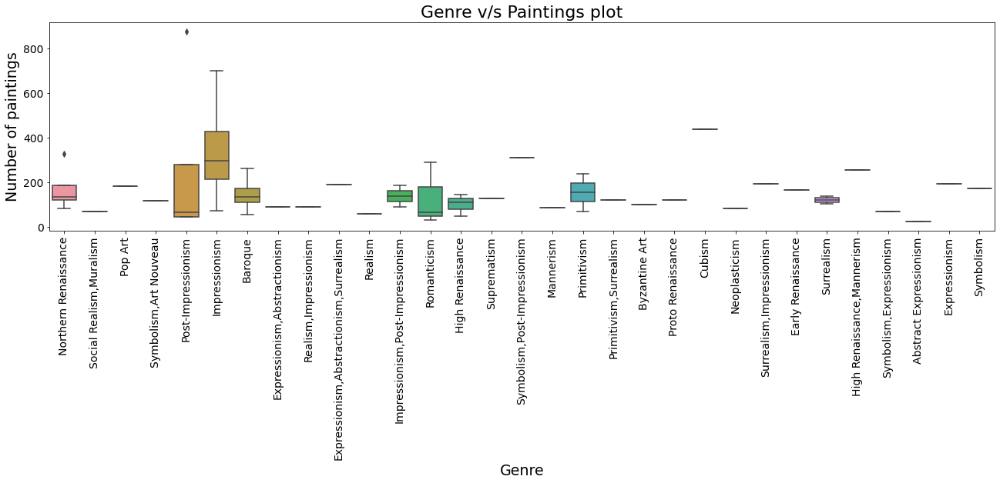

In [ ]:
plt.figure(figsize=(22,5))
sns.boxplot(x = "genre", y = "paintings", data = artists)
plt.xticks(rotation=90)
plt.title("Genre v/s Paintings plot")
plt.xlabel("Genre") 
plt.ylabel("Number of paintings")
plt.show()

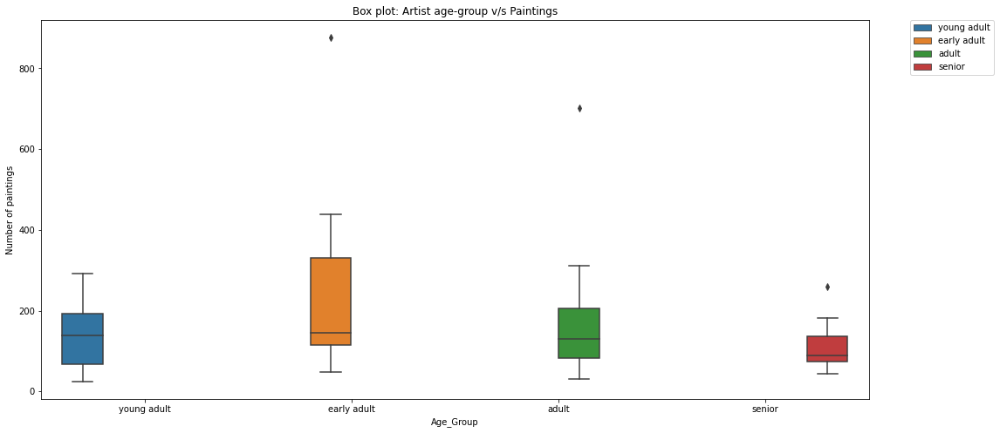

In [ ]:
plt.figure(figsize=(17,8))
sns.boxplot(x = "age_group", y = "paintings", hue = "age_group", data = artists)
plt.title("Box plot: Artist age-group v/s Paintings")
plt.xlabel("Age_Group") 
plt.ylabel("Number of paintings")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.show()

<Figure size 864x864 with 0 Axes>

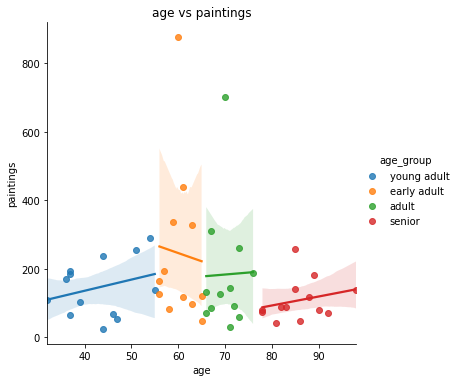

In [ ]:
plt.figure(figsize=(12,12))
sns.lmplot(x='age',y='paintings',hue = "age_group", data=artists)
plt.xlabel('age')
plt.ylabel('paintings')
plt.title('age vs paintings')
plt.show()

No handles with labels found to put in legend.


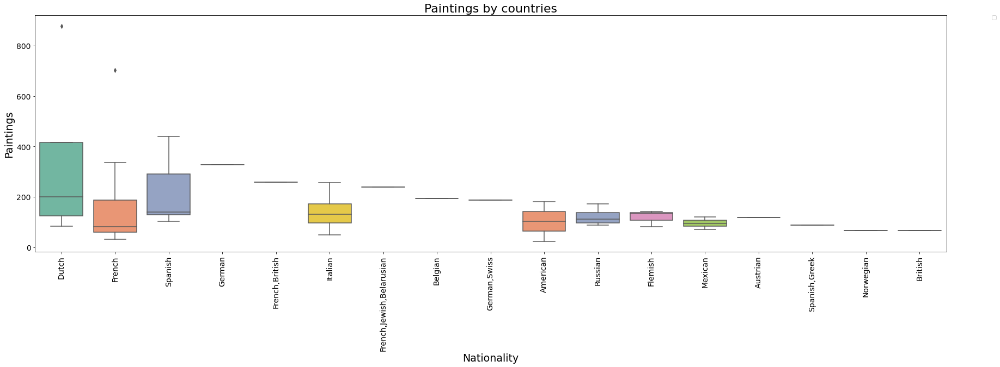

In [ ]:
artist = artists.copy()
artist = artist.sort_values(["paintings"], ascending=False)
plt.figure(figsize=(30,8))
sns.boxplot(x=artist['nationality'],y=artist['paintings'], palette="Set2")
plt.title('Paintings by countries')
plt.xlabel('Nationality')
plt.ylabel('Paintings')
plt.xticks(rotation=90)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.show()

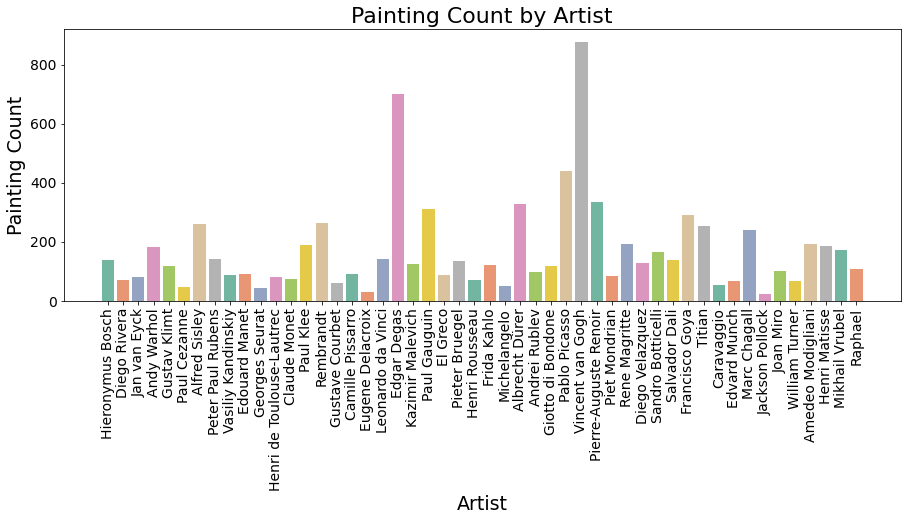

In [ ]:
figsize=(15, 5)
ticksize = 14
titlesize = ticksize + 8
labelsize = ticksize + 5

params = {'figure.figsize' : figsize,
          'axes.labelsize' : labelsize,
          'axes.titlesize' : titlesize,
          'xtick.labelsize': ticksize,
          'ytick.labelsize': ticksize}

plt.rcParams.update(params)

col1 = "name"
col2 = "paintings"
col3 = "nationality"
sns.barplot(x=col1, y=col2, palette="Set2", data=artists)
plt.title("Painting Count by Artist")
plt.xlabel("Artist")
plt.ylabel("Painting Count")
plt.xticks(rotation=90)
plt.plot()
plt.savefig('painting_count_by_artist')

In [ ]:
artists['median_age'] = (artists['birth'] + (artists['death'] - artists['birth'])/2).astype(int)
artists

,id,name,genre,nationality,bio,wikipedia,paintings,birth,death,age,age_group,median_age
0,10,Hieronymus Bosch,Northern Renaissance,Dutch,Hieronymus Bosch ( (listen); Dutch: [ɦijeːˈroː...,http://en.wikipedia.org/wiki/Hieronymus_Bosch,137,1887,1985,98,senior,1936
1,2,Diego Rivera,"Social Realism,Muralism",Mexican,Diego María de la Concepción Juan Nepomuceno E...,http://en.wikipedia.org/wiki/Diego_Rivera,70,1881,1973,92,senior,1927
2,29,Jan van Eyck,Northern Renaissance,Flemish,Jan van Eyck (Dutch: [ˈjɑn vɑn ˈɛik]) (before ...,http://en.wikipedia.org/wiki/Jan_van_Eyck,81,1893,1983,90,senior,1938
3,45,Andy Warhol,Pop Art,American,"Andy Warhol (; born Andrew Warhola; August 6, ...",https://en.wikipedia.org/wiki/Andy_Warhol,181,1475,1564,89,senior,1519
4,9,Gustav Klimt,"Symbolism,Art Nouveau",Austrian,"Gustav Klimt (July 14, 1862 – February 6, 1918...",http://en.wikipedia.org/wiki/Gustav_Klimt,117,1488,1576,88,senior,1532
5,38,Paul Cezanne,Post-Impressionism,French,Paul Cézanne (US: or UK: ; French: [pɔl sezan...,https://en.wikipedia.org/wiki/Paul_Cézanne,47,1840,1926,86,senior,1883
6,20,Alfred Sisley,Impressionism,"French,British",Alfred Sisley (; French: [sislɛ]; 30 October 1...,http://en.wikipedia.org/wiki/Alfred_Sisley,259,1904,1989,85,senior,1946
7,14,Peter Paul Rubens,Baroque,Flemish,Sir Peter Paul Rubens (; Dutch: [ˈrybə(n)s]; 2...,http://en.wikipedia.org/wiki/Peter_Paul_Rubens,141,1869,1954,85,senior,1911
8,1,Vasiliy Kandinskiy,"Expressionism,Abstractionism",Russian,Wassily Wassilyevich Kandinsky (Russian: Васи́...,http://en.wikipedia.org/wiki/Wassily_Kandinsky,88,1834,1917,83,senior,1875
9,6,Edouard Manet,"Realism,Impressionism",French,Édouard Manet (US: ; UK: ; French: [edwaʁ manɛ...,http://en.wikipedia.org/wiki/Édouard_Manet,90,1746,1828,82,senior,1787


In [ ]:
import matplotlib.pyplot as plt
import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')
nltk.download('punkt')
from nltk.tokenize import word_tokenize
from wordcloud import WordCloud

class WordCloudGeneration:
    def preprocessing(self, data):
        # convert all words to lowercase
        data = [item.lower() for item in data]
        # load the stop_words of english
        stop_words = set(stopwords.words('english'))
        # concatenate all the data with spaces.
        paragraph = ' '.join(data)
        # tokenize the paragraph using the inbuilt tokenizer
        word_tokens = word_tokenize(paragraph) 
        # filter words present in stopwords list 
        preprocessed_data = ' '.join([word for word in word_tokens if not word in stop_words])
        print("\n Preprocessed Data: " ,preprocessed_data)
        return preprocessed_data

    def create_word_cloud(self, final_data):
        # initiate WordCloud object with parameters width, height, maximum font size and background color
        # call the generate method of WordCloud class to generate an image
        wordcloud = WordCloud(width=1600, height=800, max_font_size=200, background_color="black").generate(final_data)
        # plt the image generated by WordCloud class
        plt.figure(figsize=(12,10))
        plt.imshow(wordcloud)
        plt.axis("off")
        plt.show()

wordcloud_generator = WordCloudGeneration()
# you may uncomment the following line to use custom input
# input_text = input("Enter the text here: ")


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [ ]:
list_of_names = artists['genre'].to_list()
def converttostr(input_seq, seperator):
   # Join all the strings in list
   final_str = seperator.join(input_seq)
   return final_str
seperator = ', '
input_text = converttostr(list_of_names, seperator)


 Preprocessed Data:  primitivism cubism surrealism high renaissance high renaissance mannerism impressionism surrealism impressionism post-impressionism impressionism romanticism symbolism expressionism expressionism abstractionism impressionism romanticism impressionism post-impressionism mannerism neoplasticism social realism muralism proto renaissance byzantine art surrealism impressionism high renaissance post-impressionism northern renaissance primitivism romanticism early renaissance baroque baroque baroque expressionism abstractionism surrealism impressionism pop art realism northern renaissance suprematism symbolism art nouveau symbolism post-impressionism symbolism realism impressionism primitivism surrealism northern renaissance northern renaissance abstract expressionism baroque post-impressionism high renaissance post-impressionism expressionism post-impressionism


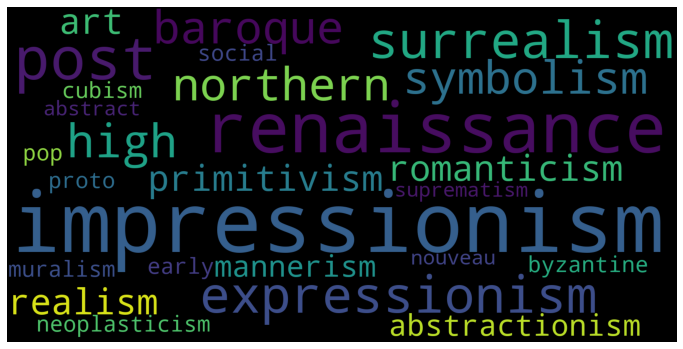

In [ ]:
input_text = input_text
input_text = input_text.split(',')
clean_data = wordcloud_generator.preprocessing(input_text)
wordcloud_generator.create_word_cloud(clean_data)

# Assumption: Bio affects the type of the painter

In [ ]:
from io import StringIO
col = ['bio', 'genre']
artist = artist[col]
artist.columns = ['bio', 'genre']
artist['genre_enc'] = artist['genre'].factorize()[0]
category_id_df = artist[['genre', 'genre_enc']].drop_duplicates().sort_values('genre_enc')
category_to_id = dict(category_id_df.values)
id_to_category = dict(category_id_df[['genre_enc', 'genre']].values)
artist.head()

NameError: ignored

In [ ]:
artist3 = artist.copy()
punc = '''!()-[]1234567890{};:'"\,<>./?@#$%^&*_~'''
def stringToList(string):
    listRes = list(string.split(" "))
    return listRes  
# Removing punctuations in string 
# Using loop + punctuation string 
def punct(text, punc):
    for ele in text:  
        if ele in punc:  
           text = text.replace(ele, "")
           text = text.replace("thcentury", "")
           text = text.replace("th century", "")
    return text
for i in range(1,50):
  artist3['bio'][i] = punct(artist3['bio'][i], punc)
artist3.head()

NameError: ignored

In [ ]:
(punct(str(artist3['bio'][2]), punc))

'Joan Miró i Ferrà  Catalan ʒuˈam miˈɾo j fəˈra  April  –  December  was a Spanish painter sculptor and ceramicist born in Barcelona A museum dedicated to his work the Fundació Joan Miró was established in his native city of Barcelona in  and another the Fundació Pilar i Joan Miró was established in his adoptive city of Palma de Mallorca in '

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
tfidf = TfidfVectorizer(sublinear_tf=True, min_df=5, norm='l2', encoding='latin-1', ngram_range=(1, 2), stop_words='english')
features = tfidf.fit_transform(artist3.bio).toarray()
labels = artist3.genre_enc
features.shape

(50, 81)

In [ ]:
from sklearn.feature_selection import chi2
import numpy as np
N = 2
for Product, category_id in sorted(category_to_id.items()):
  features_chi2 = chi2(features, labels == category_id)
  indices = np.argsort(features_chi2[0])
  feature_names = np.array(tfidf.get_feature_names())[indices]
  unigrams = [v for v in feature_names if len(v.split(' ')) == 1]
  bigrams = [v for v in feature_names if len(v.split(' ')) == 2]
  print("# '{}':".format(Product))
  print("  . Most correlated unigrams:\n. {}".format('\n. '.join(unigrams[-N:])))
  print("  . Most correlated bigrams:\n. {}".format('\n. '.join(bigrams[-N:])))

# 'Abstract Expressionism':
  . Most correlated unigrams:
. august
. paul
  . Most correlated bigrams:
. french artist
. painter printmaker
# 'Baroque':
  . Most correlated unigrams:
. history
. scenes
  . Most correlated bigrams:
. modern art
. french artist
# 'Byzantine Art':
  . Most correlated unigrams:
. greatest
. russian
  . Most correlated bigrams:
. french artist
. painter printmaker
# 'Cubism':
  . Most correlated unigrams:
. spanish
. influential
  . Most correlated bigrams:
. french artist
. painter printmaker
# 'Early Renaissance':
  . Most correlated unigrams:
. early
. italian
  . Most correlated bigrams:
. painter printmaker
. italian painter
# 'Expressionism':
  . Most correlated unigrams:
. pronunciation
. worked
  . Most correlated bigrams:
. french artist
. painter printmaker
# 'Expressionism,Abstractionism':
  . Most correlated unigrams:
. december
. russian
  . Most correlated bigrams:
. french artist
. painter printmaker
# 'Expressionism,Abstractionism,Surrealism

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.naive_bayes import MultinomialNB
X_train, X_test, y_train, y_test = train_test_split(artist['bio'], artist['genre'], random_state = 0)
count_vect = CountVectorizer()
X_train_counts = count_vect.fit_transform(X_train)
tfidf_transformer = TfidfTransformer()
X_train_tfidf = tfidf_transformer.fit_transform(X_train_counts)
clf = MultinomialNB().fit(X_train_tfidf, y_train)

In [ ]:
print(clf.predict(count_vect.transform(["Salvador Domingo Felipe Jacinto Dalí i Domènech, 1st Marquis of Dalí de Púbol (11 May 1904 – 23 January 1989), known professionally as Salvador Dalí (; Catalan: [səlβəˈðo ðəˈli]; Spanish: [salβaˈðoɾ ðaˈli]), was a prominent Spanish surrealist born in Figueres, Catalonia, Spain."])))

['Surrealism']


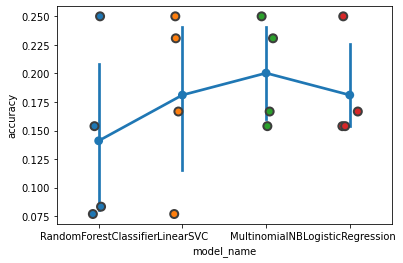

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.model_selection import cross_val_score
models = [
    RandomForestClassifier(n_estimators=30, max_depth=3, random_state=0),
    LinearSVC(),
    MultinomialNB(),
    LogisticRegression(random_state=0),
]
CV = 4
cv_df = pd.DataFrame(index=range(CV * len(models)))
entries = []
for model in models:
  model_name = model.__class__.__name__
  accuracies = cross_val_score(model, features, labels, scoring='accuracy', cv=CV)
  for fold_idx, accuracy in enumerate(accuracies):
    entries.append((model_name, fold_idx, accuracy))
cv_df = pd.DataFrame(entries, columns=['model_name', 'fold_idx', 'accuracy'])
import seaborn as sns
sns.pointplot(x='model_name', y='accuracy', data=cv_df)
sns.stripplot(x='model_name', y='accuracy', data=cv_df, 
              size=8, jitter=True, edgecolor="gray", linewidth=2)
plt.show()

# Enough visualisation! Let's model

In [46]:
from keras.preprocessing.image import load_img, save_img, img_to_array

def preprocess_image(image_path):
    
    from keras.applications import vgg19
    img = load_img(image_path)
    new_width  = 100
    new_height = 100
    img = img.resize((new_width, new_height))
    img = img_to_array(img)
    img=img.astype(int)
    return img

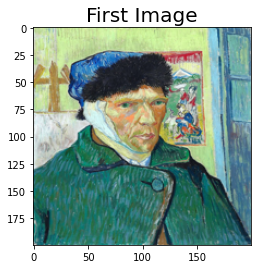

In [47]:
Path = '/content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data/images/images/'
plt.figure()
plt.title("First Image",fontsize=20)
img1 = load_img(Path + 'Vincent_van_Gogh/Vincent_van_Gogh_108.jpg')
new_width  = 200
new_height = 200
img1 = img1.resize((new_width, new_height))
img1 = img_to_array(img1)
plt.imshow(img1.astype(int))

In [104]:
all_paint=[]
"""artists=os.listdir(Path)
for artist in artists:
    paint=os.listdir(Path+artist)
    for paints in paint:
        all_paint.append(preprocess_image(Path+artist+'/'+paints))

len(all_paint)"""
paint=os.listdir(Path+'Vincent_van_Gogh')
for paints in paint:
  #print(Path+'Vincent_van_Gogh'+'/'+paints)
  all_paint.append(preprocess_image(Path+'Vincent_van_Gogh'+'/'+paints))

In [105]:
all_paint=np.stack(all_paint)
all_paint=all_paint.astype('float32')/255
all_paint.shape

(877, 100, 100, 3)

In [119]:
noise_factor=0.05
x_train_noisy=all_paint+noise_factor*np.random.normal(loc=0.0,scale=1.0,size=all_paint.shape)
x_train_noisy=np.clip(x_train_noisy,0.,1.)

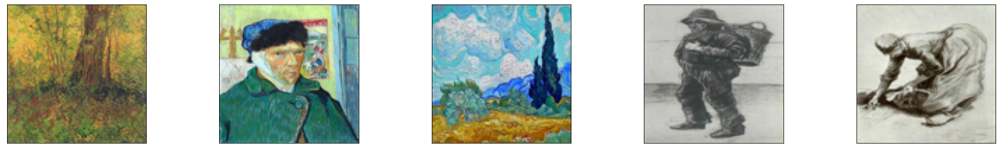

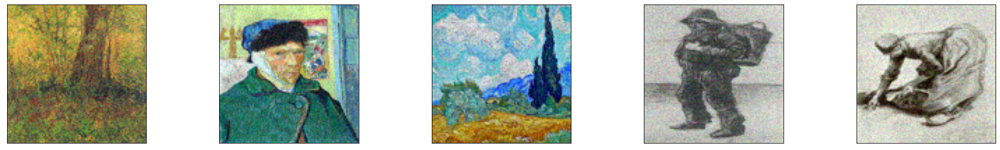

In [120]:

n=17
plt.figure(figsize=(100,4))
for i in range (12,n):
    i=i+1
    ax=plt.subplot(1,n,i)
    plt.imshow(all_paint[i])
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

plt.figure(figsize=(100,4))
for i in range (12,n):
    i=i+1
    ax=plt.subplot(1,n,i)
    plt.imshow(x_train_noisy[i])
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

In [121]:
x_test_noisy=x_train_noisy[round(len(x_train_noisy)*80/100):,:,:,:]
x_test=all_paint[round(len(all_paint)*80/100):,:,:,:]
x_train_noisy=x_train_noisy[:round(len(x_train_noisy)*80/100),:,:,:]
x_train=all_paint[:round(len(all_paint)*80/100),:,:,:]

In [ ]:
def plot_training(history):
    acc = history['accuracy']
    val_acc = history['val_accuracy']
    loss = history['loss']
    val_loss = history['val_loss']
    epochs = range(len(acc))

    fig, axes = plt.subplots(1, 2, figsize=(15,5))
    
    axes[0].plot(epochs, acc, 'r-', label='Training Accuracy')
    axes[0].plot(epochs, val_acc, 'b--', label='Validation Accuracy')
    axes[0].set_title('Training and Validation Accuracy')
    axes[0].legend(loc='best')

    axes[1].plot(epochs, loss, 'r-', label='Training Loss')
    axes[1].plot(epochs, val_loss, 'b--', label='Validation Loss')
    axes[1].set_title('Training and Validation Loss')
    axes[1].legend(loc='best')
    
    plt.show()
    
#plot_training(history)

#CNN block model for noise filtering

In [ ]:
import numpy as np

def my_imfilter(image, filter):


  assert filter.shape[0] % 2 == 1
  assert filter.shape[1] % 2 == 1

  filtered_image = image.copy()
  pad_y = int(np.floor(filter.shape[0]/2))
  pad_x = int(np.floor(filter.shape[1]/2))
  image_y = image.shape[0];image_x = image.shape[1]
  if (image_x*image_y==image.size):
    image_dupl = np.pad(image,((pad_y,pad_y),(pad_x,pad_x)),'reflect')
    for i in range(image_y):
      for j in range(image_x):
        g = image_dupl[i:i+filter.shape[0],j:j+filter.shape[1]]
        filtered_image[i,j] = np.sum(np.multiply(g,filter))
    return filtered_image
  else:
    for i in range(3):
      image_dupl = np.pad(image[:,:,i],((pad_y,pad_y),(pad_x,pad_x)),'reflect')
      for j in range(image_y):
        for k in range(image_x):
          c = image_dupl[j:j+filter.shape[0],k:k+filter.shape[1]]
          filtered_image[j,k,i] = np.sum(np.multiply(c,filter))
    return filtered_image

In [ ]:
model=Sequential()

model.add(keras.layers.Conv2D(64,(3,3),activation='relu',padding='same',input_shape=(100,100,3)))
model.add(keras.layers.MaxPooling2D((2,2),padding='same'))
model.add(keras.layers.Conv2D(32,(3,3),activation='relu',padding='same'))
model.add(keras.layers.MaxPooling2D((2,2),padding='same'))


model.add(keras.layers.Conv2D(32,(3,3),activation='relu',padding='same'))
model.add(keras.layers.UpSampling2D((2,2)))
model.add(keras.layers.Conv2D(64,(3,3),activation='relu',padding='same'))
model.add(keras.layers.UpSampling2D((2,2)))
model.add(keras.layers.Conv2D(3,(3,3),activation='sigmoid',padding='same'))

In [ ]:
model.compile(optimizer='adam',loss='binary_crossentropy')
history3 = model.fit(x_train_noisy,x_train,epochs=50,batch_size=64,shuffle=True,validation_data=(x_test_noisy,x_test))

Epoch 1/50
11/11 [==============================] - 2s 144ms/step - loss: 0.5997 - val_loss: 0.5818
Epoch 2/50
11/11 [==============================] - 1s 122ms/step - loss: 0.5804 - val_loss: 0.5738
Epoch 3/50
11/11 [==============================] - 1s 121ms/step - loss: 0.5719 - val_loss: 0.5718
Epoch 4/50
11/11 [==============================] - 1s 120ms/step - loss: 0.5744 - val_loss: 0.5706
Epoch 5/50
11/11 [==============================] - 1s 121ms/step - loss: 0.5733 - val_loss: 0.5699
Epoch 6/50
11/11 [==============================] - 1s 121ms/step - loss: 0.5718 - val_loss: 0.5695
Epoch 7/50
11/11 [==============================] - 1s 121ms/step - loss: 0.5704 - val_loss: 0.5691
Epoch 8/50
11/11 [==============================] - 1s 122ms/step - loss: 0.5701 - val_loss: 0.5688
Epoch 9/50
11/11 [==============================] - 1s 122ms/step - loss: 0.5720 - val_loss: 0.5687
Epoch 10/50
11/11 [==============================] - 1s 121ms/step - loss: 0.5670 - val_loss: 0.5688

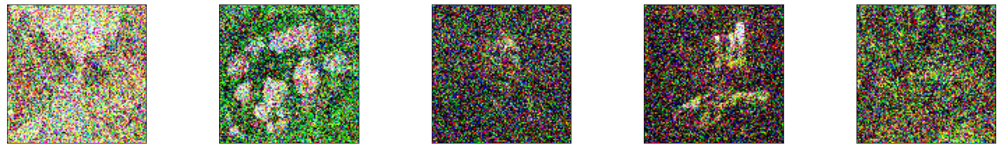

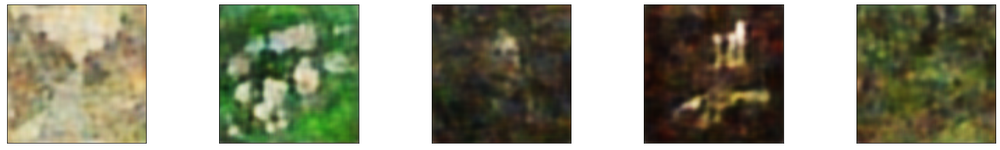

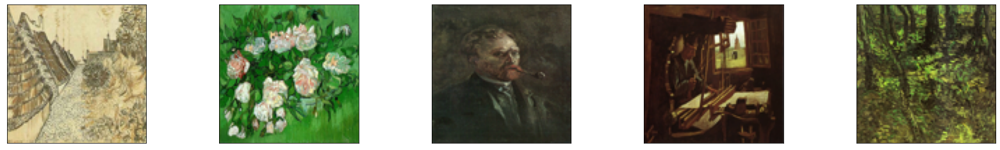

In [ ]:
essai=model.predict(x_test_noisy)

n=17
plt.figure(figsize=(100,4))
for i in range (12,n):
    i=i+1
    ax=plt.subplot(1,n,i)
    plt.imshow(x_test_noisy[i])
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()


plt.figure(figsize=(100,4))
for i in range (12,n):
    i=i+1
    ax=plt.subplot(1,n,i)
    plt.imshow(essai[i])
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

plt.figure(figsize=(100,4))
for i in range (12,n):
    i=i+1
    ax=plt.subplot(1,n,i)
    plt.imshow(x_test[i])
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

In [ ]:
plot_training(history3)

TypeError: ignored

#Autoencoder block for denoising

In [57]:
from keras import losses
class Improved_Autoencoder(Model):
  def __init__(self):
    super(Improved_Autoencoder, self).__init__()
    self.encoder = keras.Sequential([
      keras.layers.Input(shape=(100,100,3)), 
      keras.layers.Conv2D(128, (3,3), activation='relu', padding='same', strides=2),
      keras.layers.Conv2D(64, (4,4), activation='relu', padding='same', strides=2),
      keras.layers.Conv2D(32, (3,3), activation='relu', padding='same', strides=1)])

    self.decoder = keras.Sequential([
      keras.layers.Conv2DTranspose(32, kernel_size=3, strides=1, activation='relu', padding='same'),
      keras.layers.Conv2DTranspose(64, kernel_size=4, strides=2, activation='relu', padding='same'),
      keras.layers.Conv2DTranspose(128, kernel_size=3, strides=2, activation='relu', padding='same'),
      keras.layers.Conv2D(3, kernel_size=(3,3), activation='sigmoid', padding='same')])
    
  def call(self, x):
    encoded = self.encoder(x)
    decoded = self.decoder(encoded)
    return decoded

autoencoder = Improved_Autoencoder()

autoencoder.compile(optimizer='adam', loss=losses.MeanSquaredError())

In [58]:
autoencoder.encoder.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_376 (Conv2D)          (None, 50, 50, 128)       3584      
_________________________________________________________________
conv2d_377 (Conv2D)          (None, 25, 25, 64)        131136    
_________________________________________________________________
conv2d_378 (Conv2D)          (None, 25, 25, 32)        18464     
Total params: 153,184
Trainable params: 153,184
Non-trainable params: 0
_________________________________________________________________


In [ ]:
def weightedLoss(originalLossFunc, weightsList):

    def lossFunc(true, pred):

        axis = -1 #if channels last 
        #axis=  1 #if channels first


        #argmax returns the index of the element with the greatest value
        #done in the class axis, it returns the class index    
        classSelectors = K.argmax(true, axis=axis) 
            #if your loss is sparse, use only true as classSelectors

        #considering weights are ordered by class, for each class
        #true(1) if the class index is equal to the weight index   
        classSelectors = [K.equal(i, classSelectors) for i in range(len(weightsList))]

        #casting boolean to float for calculations  
        #each tensor in the list contains 1 where ground true class is equal to its index 
        #if you sum all these, you will get a tensor full of ones. 
        classSelectors = [K.cast(x, K.floatx()) for x in classSelectors]

        #for each of the selections above, multiply their respective weight
        weights = [sel * w for sel,w in zip(classSelectors, weightsList)] 

        #sums all the selections
        #result is a tensor with the respective weight for each element in predictions
        weightMultiplier = weights[0]
        for i in range(1, len(weights)):
            weightMultiplier = weightMultiplier + weights[i]


        #make sure your originalLossFunc only collapses the class axis
        #you need the other axes intact to multiply the weights tensor
        loss = originalLossFunc(true,pred) 
        loss = loss * weightMultiplier

        return loss
    return lossFunc

In [ ]:
from keras.models import Model
from keras.layers import Dense, Input
from keras.layers import Conv2D, Flatten, Lambda
from keras.layers import Reshape, Conv2DTranspose
from keras import backend as K
from keras.losses import binary_crossentropy
from numpy import reshape
from functools import partial

"""def custom_loss_1(y_true, y_pred):
    return K.mean(K.abs(y_true-y_pred)*class_weights)
cl4 = partial(custom_loss_1, weights=weights_tensor)"""


latent_dim = 32
input_img = Input(shape=(224, 224, 3),)

def sampling(args):
    z_mean, z_log_var = args
    batch = K.shape(z_mean)[0]
    dim = K.int_shape(z_mean)[1]
    epsilon = K.random_normal(shape=(batch, dim))
    return z_mean + K.exp(0.5 * z_log_var) * epsilon


h=Conv2D(128, kernel_size=3, activation='relu', padding='same',strides=2)(input_img)
enc_ouput=Conv2D(64, kernel_size=3, activation='relu', padding='same',strides=2)(h)

shape = K.int_shape(enc_ouput)
x = Flatten()(enc_ouput)
x = Dense(32, activation='relu')(x)
z_mean = Dense(latent_dim, name='z_mean')(x)
z_log_var = Dense(latent_dim, name='z_log_var')(x)
z = Lambda(sampling, output_shape=(latent_dim,), name='z')([z_mean, z_log_var])

encoder = Model(input_img, [z_mean, z_log_var, z], name='encoder')
encoder.summary()

# decoder 
latent_inputs = Input(shape=(latent_dim,), name='z_sampling')
x = Dense(shape[1] * shape[2] * shape[3], activation='relu')(latent_inputs)
x = Reshape((shape[1], shape[2], shape[3]))(x)

x=Conv2DTranspose(64, kernel_size=3, activation='relu', strides=2,padding='same')(x)
x=Conv2DTranspose(128, kernel_size=3, activation='relu', strides=2,padding='same')(x)
dec_output = Conv2DTranspose(3, kernel_size=3, activation='relu',padding='same')(x)

decoder = Model(latent_inputs, dec_output, name='decoder')
decoder.summary()


# autoencoder definition
outputs = decoder(encoder(input_img)[2])
vae1 = Model(input_img, outputs, name='vae')

reconst_loss = binary_crossentropy(K.flatten(input_img), K.flatten(outputs))
reconst_loss *= 224 * 224
kl_loss = 1 + z_log_var - K.square(z_mean) - K.exp(z_log_var)
kl_loss = K.sum(kl_loss, axis=-1)
kl_loss *= -0.5
vae_loss = K.mean(reconst_loss + kl_loss)

vae1.add_loss(vae_loss)
#vae1.add_loss(weightedLoss(vae_loss, class_weights))

#vae1.add_loss(cl4)
vae1.compile(optimizer= 'adam')
#vae1.compile(loss = weightedLoss(vae_loss, class_weights), optimizer='adam', sample_weight_mode="temporal")

vae1.summary()



Model: "encoder"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 112, 112, 128 3584        input_2[0][0]                    
__________________________________________________________________________________________________
conv2d_3 (Conv2D)               (None, 56, 56, 64)   73792       conv2d_2[0][0]                   
__________________________________________________________________________________________________
flatten_1 (Flatten)             (None, 200704)       0           conv2d_3[0][0]                   
____________________________________________________________________________________________

In [ ]:
weightedLoss(vae_loss, class_weights)

<function __main__.weightedLoss.<locals>.lossFunc>

#Augmentation

In [ ]:
batch_size = 64
train_input_shape = (224, 224, 3)
n_classes = artists_top.shape[0]
def fixed_generator(generator):
    for batch in generator:
        yield (batch, batch)
train_datagen = ImageDataGenerator(validation_split=0.2,
                                   rescale=1./255.,
                                   rotation_range=45,
                                   width_shift_range=0.5,
                                   height_shift_range=0.5,
                                   shear_range=5,
                                   zoom_range=0.7,
                                   horizontal_flip=True,
                                   vertical_flip=True,
                                  )

"""train_generator = train_datagen.flow_from_directory(directory=images_dir,
                                                    class_mode='input',
                                                    target_size=train_input_shape[0:2],
                                                    batch_size=batch_size,
                                                    subset="training",
                                                    shuffle=True,
                                                    classes=artists_top_name.tolist()
                                                   )

valid_generator = train_datagen.flow_from_directory(directory=images_dir,
                                                    class_mode='input',
                                                    target_size=train_input_shape[0:2],
                                                    batch_size=batch_size,
                                                    subset="validation",
                                                    shuffle=True,
                                                    classes=artists_top_name.tolist()
                                                   )"""

train_generator = train_datagen.flow_from_directory(
        directory=images_dir,
        target_size=train_input_shape[0:2],
        batch_size=batch_size,
        subset="training",
        class_mode=None,
        classes=artists_top_name.tolist())


validation_generator = train_datagen.flow_from_directory(
        images_dir,
        target_size=train_input_shape[0:2],
        batch_size=batch_size,
        subset="validation",
        class_mode=None,
        classes=artists_top_name.tolist())



STEP_SIZE_TRAIN = train_generator.n//train_generator.batch_size
STEP_SIZE_VALID = validation_generator.n//validation_generator.batch_size
print("Total number of batches =", STEP_SIZE_TRAIN, "and", STEP_SIZE_VALID)

Found 3456 images belonging to 11 classes.
Found 858 images belonging to 11 classes.
Total number of batches = 54 and 13


#Building

In [ ]:

n_epoch = 50
model_1 = vae1.fit_generator(generator=fixed_generator(train_generator), steps_per_epoch=STEP_SIZE_TRAIN,
                              validation_data=fixed_generator(validation_generator), validation_steps=STEP_SIZE_VALID,
                              epochs=n_epoch,
                              shuffle=True,
                              verbose=1,
                              #callbacks=[reduce_lr],
                              #use_multiprocessing=True,
                              #workers=16,
                             )

Epoch 1/50
216/216 [==============================] - 1547s 7s/step - loss: 67634.0342 - val_loss: 31082.2832
Epoch 2/50
216/216 [==============================] - 121s 562ms/step - loss: 30574.6679 - val_loss: 30294.1953
Epoch 3/50
216/216 [==============================] - 121s 561ms/step - loss: 30602.5397 - val_loss: 30234.7656
Epoch 4/50
216/216 [==============================] - 121s 563ms/step - loss: 29761.1043 - val_loss: 29598.9121
Epoch 5/50
216/216 [==============================] - 120s 560ms/step - loss: 29645.3213 - val_loss: 29509.8203
Epoch 6/50
216/216 [==============================] - 120s 560ms/step - loss: 29374.5330 - val_loss: 29536.5723
Epoch 7/50
216/216 [==============================] - 121s 561ms/step - loss: 29318.2671 - val_loss: 29442.6582
Epoch 8/50
216/216 [==============================] - 120s 559ms/step - loss: 29255.5560 - val_loss: 29273.4219
Epoch 9/50
 33/216 [===>..........................] - ETA: 1:24 - loss: 29109.6922

KeyboardInterrupt: ignored

#2nd attempt

In [ ]:
n_epoch = 50
model_1 = vae1.fit_generator(generator=fixed_generator(train_generator), steps_per_epoch=STEP_SIZE_TRAIN,
                              validation_data=fixed_generator(validation_generator), validation_steps=STEP_SIZE_VALID,
                              epochs=n_epoch,
                              #class_weight=class_weights,
                              shuffle=True,
                              verbose=1,
                              #callbacks=[reduce_lr],
                              #use_multiprocessing=True,
                              #workers=16,
                             )

Epoch 1/50
 9/54 [====>.........................] - ETA: 24:36 - loss: 712173423.3368

KeyboardInterrupt: ignored

In [122]:
from keras import losses
class Improved_Autoencoder(Model):
  def __init__(self):
    super(Improved_Autoencoder, self).__init__()
    self.encoder = keras.Sequential([
      keras.layers.Input(shape=(100,100,3)), 
      keras.layers.Conv2D(128, (3,3), activation='relu', padding='same', strides=2),
      keras.layers.Conv2D(64, (4,4), activation='relu', padding='same', strides=2),
      keras.layers.Conv2D(32, (3,3), activation='relu', padding='same', strides=1)])

    self.decoder = keras.Sequential([
      keras.layers.Conv2DTranspose(32, kernel_size=3, strides=1, activation='relu', padding='same'),
      keras.layers.Conv2DTranspose(64, kernel_size=4, strides=2, activation='relu', padding='same'),
      keras.layers.Conv2DTranspose(128, kernel_size=3, strides=2, activation='relu', padding='same'),
      keras.layers.Conv2D(3, kernel_size=(3,3), activation='sigmoid', padding='same')])
    
  def call(self, x):
    encoded = self.encoder(x)
    decoded = self.decoder(encoded)
    return decoded

autoencoder = Improved_Autoencoder()

autoencoder.compile(optimizer='adam', loss=losses.MeanSquaredError(), metrics=['accuracy'])

In [123]:
my_model = autoencoder.fit(x_train_noisy, x_train,
                epochs=100,
                shuffle=True,
                validation_data=(x_test_noisy, x_test))

Epoch 1/100
22/22 [==============================] - 2s 87ms/step - loss: 0.0596 - accuracy: 0.5490 - val_loss: 0.0462 - val_accuracy: 0.6171
Epoch 2/100
22/22 [==============================] - 2s 77ms/step - loss: 0.0343 - accuracy: 0.6116 - val_loss: 0.0156 - val_accuracy: 0.6186
Epoch 3/100
22/22 [==============================] - 2s 77ms/step - loss: 0.0144 - accuracy: 0.6230 - val_loss: 0.0110 - val_accuracy: 0.6729
Epoch 4/100
22/22 [==============================] - 2s 78ms/step - loss: 0.0122 - accuracy: 0.6472 - val_loss: 0.0098 - val_accuracy: 0.6848
Epoch 5/100
22/22 [==============================] - 2s 77ms/step - loss: 0.0102 - accuracy: 0.6729 - val_loss: 0.0082 - val_accuracy: 0.7017
Epoch 6/100
22/22 [==============================] - 2s 78ms/step - loss: 0.0081 - accuracy: 0.6960 - val_loss: 0.0074 - val_accuracy: 0.7093
Epoch 7/100
22/22 [==============================] - 2s 78ms/step - loss: 0.0077 - accuracy: 0.6926 - val_loss: 0.0072 - val_accuracy: 0.7022
Epoch 

In [124]:
encoded_imgs = autoencoder.encoder(x_test).numpy()
decoded_imgs = autoencoder.decoder(encoded_imgs).numpy()

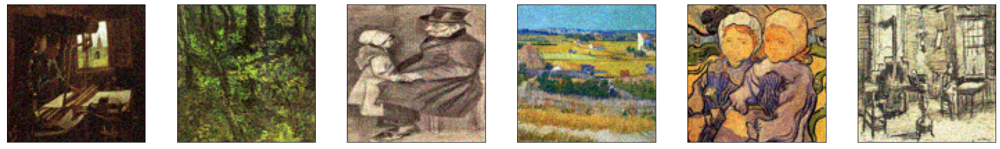

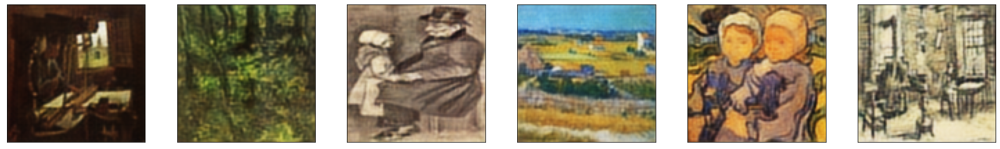

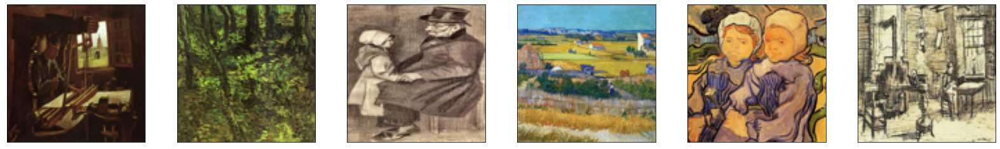

In [125]:
n=21
plt.figure(figsize=(100,4))
for i in range (15,n):
    i=i+1
    ax=plt.subplot(1,n,i)
    plt.imshow(x_test_noisy[i])
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()


plt.figure(figsize=(100,4))
for i in range (15,n):
    i=i+1
    ax=plt.subplot(1,n,i)
    plt.imshow(decoded_imgs[i])
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

plt.figure(figsize=(100,4))
for i in range (15,n):
    i=i+1
    ax=plt.subplot(1,n,i)
    plt.imshow(x_test[i])
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

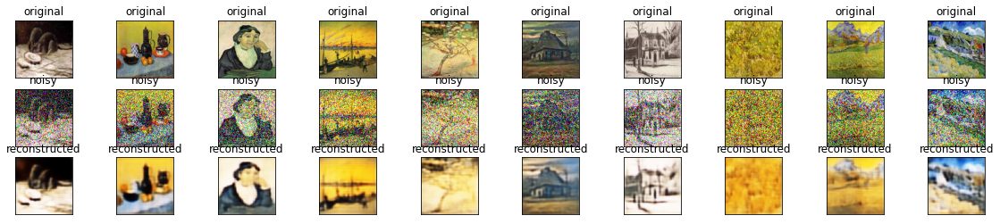

In [62]:
 n = 10
plt.figure(figsize=(20, 4))
for i in range(n):
  # display original
  ax = plt.subplot(3, n, i + 1)
  plt.imshow(x_test[i])
  plt.title("original")
  #plt.gray()
  ax.get_xaxis().set_visible(False)
  ax.get_yaxis().set_visible(False)
  # noisy one
  ax = plt.subplot(3, n, i + 1 + n)
  plt.imshow(x_test_noisy[i])
  plt.title("noisy")
  #plt.gray()
  ax.get_xaxis().set_visible(False)
  ax.get_yaxis().set_visible(False)

  # display reconstruction
  ax = plt.subplot(3, n, i + 1 + 2*n)
  plt.imshow(decoded_imgs[i])
  plt.title("reconstructed")
  #plt.gray()
  ax.get_xaxis().set_visible(False)
  ax.get_yaxis().set_visible(False)
plt.show()

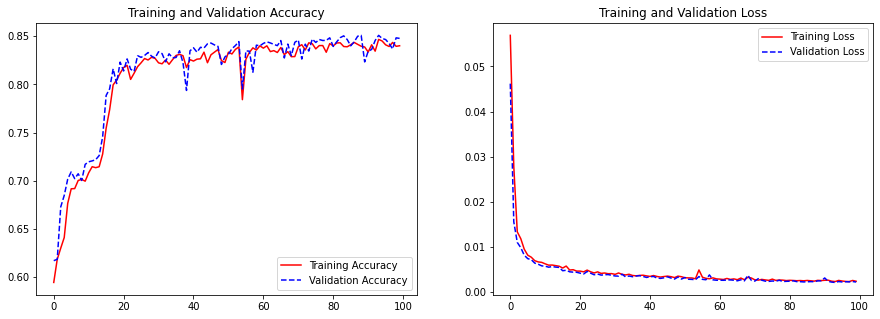

In [126]:
def plot_training(history):
    acc = history['accuracy']
    val_acc = history['val_accuracy']
    loss = history['loss']
    val_loss = history['val_loss']
    epochs = range(len(acc))

    fig, axes = plt.subplots(1, 2, figsize=(15,5))
    
    axes[0].plot(epochs, acc, 'r-', label='Training Accuracy')
    axes[0].plot(epochs, val_acc, 'b--', label='Validation Accuracy')
    axes[0].set_title('Training and Validation Accuracy')
    axes[0].legend(loc='best')

    axes[1].plot(epochs, loss, 'r-', label='Training Loss')
    axes[1].plot(epochs, val_loss, 'b--', label='Validation Loss')
    axes[1].set_title('Training and Validation Loss')
    axes[1].legend(loc='best')
    
    plt.show()
rem = my_model.history
plot_training(rem)

In [139]:
x_test=all_paint[round(len(all_paint)*80/100):,:,:,:]
x_train=all_paint[:round(len(all_paint)*80/100),:,:,:]
x_train_noisy_ws=x_train.copy()
x_test_noisy_ws=x_test.copy()

In [140]:
size=20
for element in x_train_noisy_ws:
    number1=np.random.randint(low=1, high=90, size=1)
    number1=number1[0]
    number2=np.random.randint(low=1, high=90, size=1)
    number2=number2[0]
    element[number1:number1+size,number2:number2+size,:]=1.0
for element in x_test_noisy_ws:
    number1=np.random.randint(low=1, high=90, size=1)
    number1=number1[0]
    number2=np.random.randint(low=1, high=90, size=1)
    number2=number2[0]
    element[number1:number1+size,number2:number2+size,:]=1.0

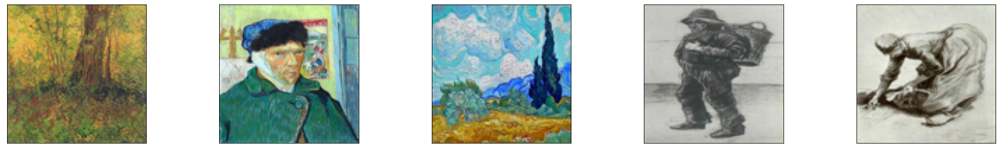

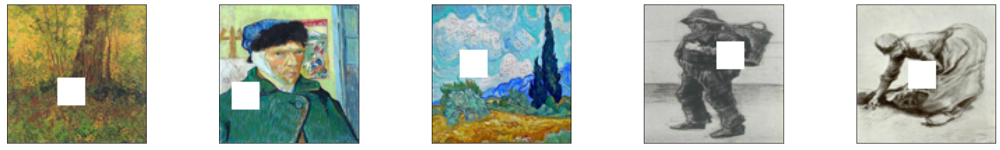

In [141]:
n = 17
plt.figure(figsize=(100,4))
for i in range (12,n):
    i=i+1
    ax=plt.subplot(1,n,i)
    plt.imshow(all_paint[i])
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

plt.figure(figsize=(100,4))
for i in range (12,n):
    i=i+1
    ax=plt.subplot(1,n,i)
    plt.imshow(x_train_noisy_ws[i])
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()


In [155]:
from keras import losses
class Improved_Autoencoder_II(Model):
  def __init__(self):
    super(Improved_Autoencoder_II, self).__init__()
    self.encoder = keras.Sequential([
      keras.layers.Input(shape=(100,100,3)), 
      #keras.layers.Conv2D(64, (3,3), activation='relu', padding='same', strides=2),                     ###Since the inputes are images. I've used Conv2D layer
      keras.layers.Conv2D(128, (3,3), activation='relu', padding='same', strides=1),
      keras.layers.Conv2D(64, (5,5), activation='relu', padding='same', strides=2),
      keras.layers.Conv2D(32, (3,3), activation='relu', padding='same', strides=2)])

    self.decoder = keras.Sequential([
      keras.layers.Conv2DTranspose(32, kernel_size=3, strides=2, activation='relu', padding='same'),
      keras.layers.Conv2DTranspose(64, kernel_size=5, strides=2, activation='relu', padding='same'),
      keras.layers.Conv2DTranspose(128, kernel_size=3, strides=1, activation='relu', padding='same'),
      #keras.layers.Conv2DTranspose(64, kernel_size=3, strides=2, activation='relu', padding='same'),
      keras.layers.Conv2D(3, kernel_size=(3,3), activation='sigmoid', padding='same')])
    
  def call(self, x):
    encoded = self.encoder(x)
    decoded = self.decoder(encoded)
    return decoded

autoencoder = Improved_Autoencoder_II()

autoencoder.compile(optimizer='adam', loss=losses.MeanSquaredError(), metrics = ['accuracy'])

In [156]:
model_box = autoencoder.fit(x_train_noisy_ws, x_train,
                epochs=150,
                shuffle=True,
                validation_data=(x_test_noisy_ws, x_test))

Epoch 1/150
22/22 [==============================] - 7s 239ms/step - loss: 0.0588 - accuracy: 0.6050 - val_loss: 0.0361 - val_accuracy: 0.6172
Epoch 2/150
22/22 [==============================] - 3s 138ms/step - loss: 0.0304 - accuracy: 0.6263 - val_loss: 0.0177 - val_accuracy: 0.6226
Epoch 3/150
22/22 [==============================] - 3s 139ms/step - loss: 0.0167 - accuracy: 0.6286 - val_loss: 0.0161 - val_accuracy: 0.6497
Epoch 4/150
22/22 [==============================] - 3s 140ms/step - loss: 0.0152 - accuracy: 0.6395 - val_loss: 0.0136 - val_accuracy: 0.7014
Epoch 5/150
22/22 [==============================] - 3s 141ms/step - loss: 0.0141 - accuracy: 0.6820 - val_loss: 0.0124 - val_accuracy: 0.7072
Epoch 6/150
22/22 [==============================] - 3s 142ms/step - loss: 0.0121 - accuracy: 0.7058 - val_loss: 0.0116 - val_accuracy: 0.6795
Epoch 7/150
22/22 [==============================] - 3s 141ms/step - loss: 0.0117 - accuracy: 0.7006 - val_loss: 0.0108 - val_accuracy: 0.7183

In [157]:
encoded_imgs = autoencoder.encoder(x_test_noisy_ws).numpy()
decoded_imgs = autoencoder.decoder(encoded_imgs).numpy()

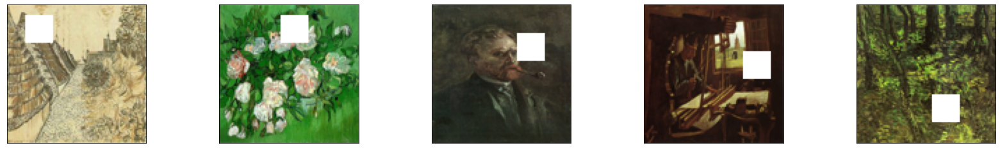

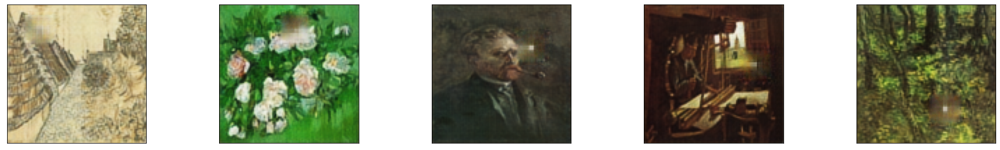

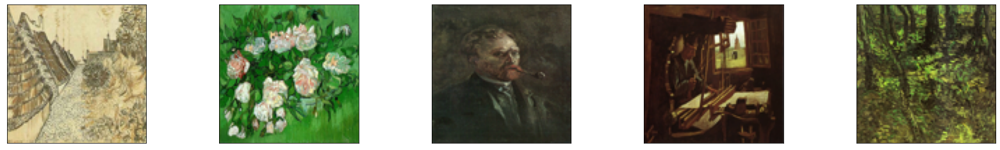

In [158]:
n=17; p = n - 5
plt.figure(figsize=(100,4))
for i in range (p,n):
    i=i+1
    ax=plt.subplot(1,n,i)
    plt.imshow(x_test_noisy_ws[i])
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()


plt.figure(figsize=(100,4))
for i in range (p,n):
    i=i+1
    ax=plt.subplot(1,n,i)
    plt.imshow(decoded_imgs[i])
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

plt.figure(figsize=(100,4))
for i in range (p,n):
    i=i+1
    ax=plt.subplot(1,n,i)
    plt.imshow(x_test[i])
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

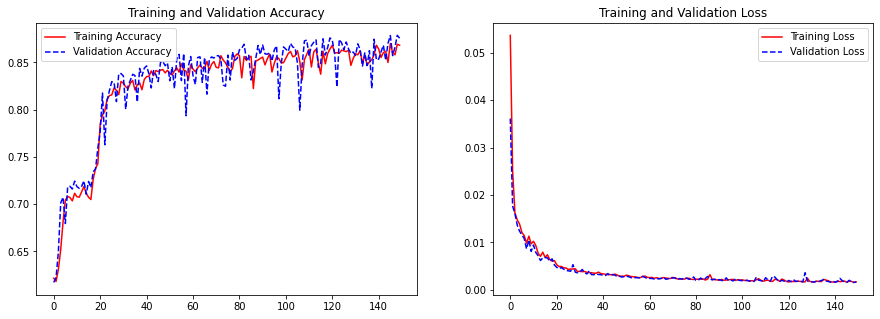

In [159]:
def plot_training(history):
    acc = history['accuracy']
    val_acc = history['val_accuracy']
    loss = history['loss']
    val_loss = history['val_loss']
    epochs = range(len(acc))

    fig, axes = plt.subplots(1, 2, figsize=(15,5))
    
    axes[0].plot(epochs, acc, 'r-', label='Training Accuracy')
    axes[0].plot(epochs, val_acc, 'b--', label='Validation Accuracy')
    axes[0].set_title('Training and Validation Accuracy')
    axes[0].legend(loc='best')

    axes[1].plot(epochs, loss, 'r-', label='Training Loss')
    axes[1].plot(epochs, val_loss, 'b--', label='Validation Loss')
    axes[1].set_title('Training and Validation Loss')
    axes[1].legend(loc='best')
    
    plt.show()

rem = model_box.history
plot_training(rem)

# Line noise fitting

In [160]:
x_train_noisy_l=x_train.copy()
x_test_noisy_l=x_test.copy()

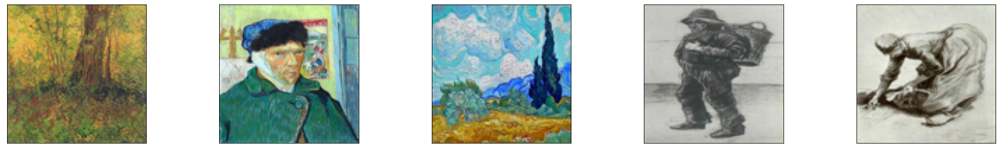

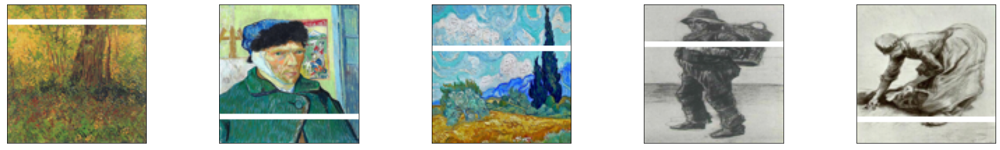

In [161]:
size=4
for element in x_train_noisy_l:
    number=np.random.randint(low=1, high=100, size=1)
    number=number[0]
    element[number:number+size,:,:]=1.0
for element in x_test_noisy_l:
    number=np.random.randint(low=1, high=100, size=1)
    number=number[0]
    element[number:number+size,:,:]=1.0
plt.figure(figsize=(100,4))
for i in range (12,n):
    i=i+1
    ax=plt.subplot(1,n,i)
    plt.imshow(x_train[i])
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

plt.figure(figsize=(100,4))
for i in range (12,n):
    i=i+1
    ax=plt.subplot(1,n,i)
    plt.imshow(x_train_noisy_l[i])
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

In [164]:
from keras import losses
class Improved_Autoencoder_II(Model):
  def __init__(self):
    super(Improved_Autoencoder_II, self).__init__()
    self.encoder = keras.Sequential([
      keras.layers.Input(shape=(100,100,3)), 
      #keras.layers.Conv2D(64, (3,3), activation='relu', padding='same', strides=2),                     ###Since the inputes are images. I've used Conv2D layer
      keras.layers.Conv2D(64, (3,3), activation='relu', padding='same', strides=1),
      keras.layers.Conv2D(128, (5,5), activation='relu', padding='same', strides=2),
      keras.layers.Conv2D(256, (3,3), activation='relu', padding='same', strides=2)])

    self.decoder = keras.Sequential([
      keras.layers.Conv2DTranspose(256, kernel_size=3, strides=2, activation='relu', padding='same'),
      keras.layers.Conv2DTranspose(128, kernel_size=5, strides=2, activation='relu', padding='same'),
      keras.layers.Conv2DTranspose(64, kernel_size=3, strides=1, activation='relu', padding='same'),
      #keras.layers.Conv2DTranspose(64, kernel_size=3, strides=2, activation='relu', padding='same'),
      keras.layers.Conv2D(3, kernel_size=(3,3), activation='sigmoid', padding='same')])
    
  def call(self, x):
    encoded = self.encoder(x)
    decoded = self.decoder(encoded)
    return decoded

autoencoder = Improved_Autoencoder_II()

autoencoder.compile(optimizer='adam', loss=losses.MeanSquaredError(), metrics=['accuracy'])

In [165]:
model_line = autoencoder.fit(x_train_noisy_l, x_train,
                epochs=100,
                shuffle=True,
                validation_data=(x_test_noisy_ws, x_test))

Epoch 1/100
22/22 [==============================] - 4s 126ms/step - loss: 0.0621 - accuracy: 0.5017 - val_loss: 0.0451 - val_accuracy: 0.5351
Epoch 2/100
22/22 [==============================] - 2s 90ms/step - loss: 0.0297 - accuracy: 0.5813 - val_loss: 0.0207 - val_accuracy: 0.6047
Epoch 3/100
22/22 [==============================] - 2s 90ms/step - loss: 0.0139 - accuracy: 0.6209 - val_loss: 0.0187 - val_accuracy: 0.6444
Epoch 4/100
22/22 [==============================] - 2s 90ms/step - loss: 0.0127 - accuracy: 0.6668 - val_loss: 0.0183 - val_accuracy: 0.6540
Epoch 5/100
22/22 [==============================] - 2s 90ms/step - loss: 0.0095 - accuracy: 0.6440 - val_loss: 0.0179 - val_accuracy: 0.6899
Epoch 6/100
22/22 [==============================] - 2s 90ms/step - loss: 0.0086 - accuracy: 0.6945 - val_loss: 0.0152 - val_accuracy: 0.7199
Epoch 7/100
22/22 [==============================] - 2s 90ms/step - loss: 0.0073 - accuracy: 0.7130 - val_loss: 0.0149 - val_accuracy: 0.6803
Epoch

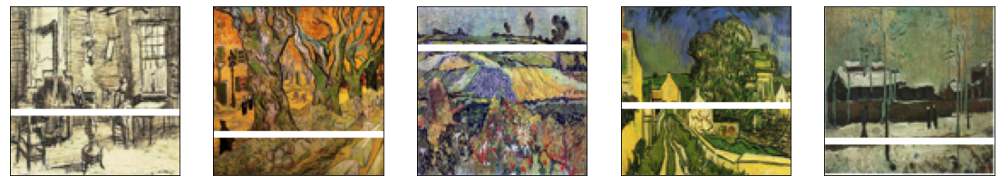

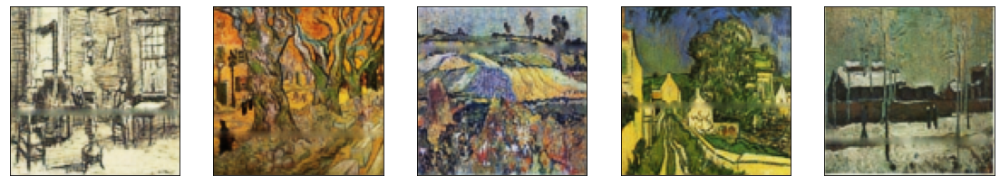

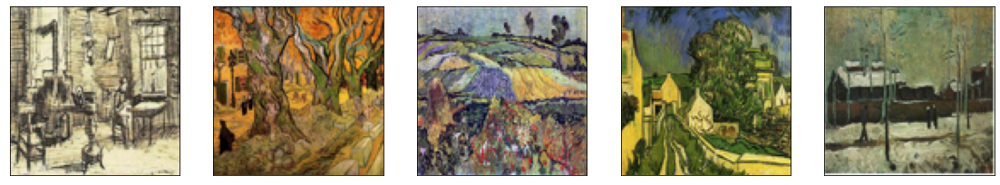

In [168]:
encoded_imgs = autoencoder.encoder(x_test_noisy_l).numpy()
decoded_imgs = autoencoder.decoder(encoded_imgs).numpy()

n=25; p = n - 5
plt.figure(figsize=(100,4))
for i in range (p,n):
    i=i+1
    ax=plt.subplot(1,n,i)
    plt.imshow(x_test_noisy_l[i])
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()


plt.figure(figsize=(100,4))
for i in range (p,n):
    i=i+1
    ax=plt.subplot(1,n,i)
    plt.imshow(decoded_imgs[i])
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

plt.figure(figsize=(100,4))
for i in range (p,n):
    i=i+1
    ax=plt.subplot(1,n,i)
    plt.imshow(x_test[i])
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

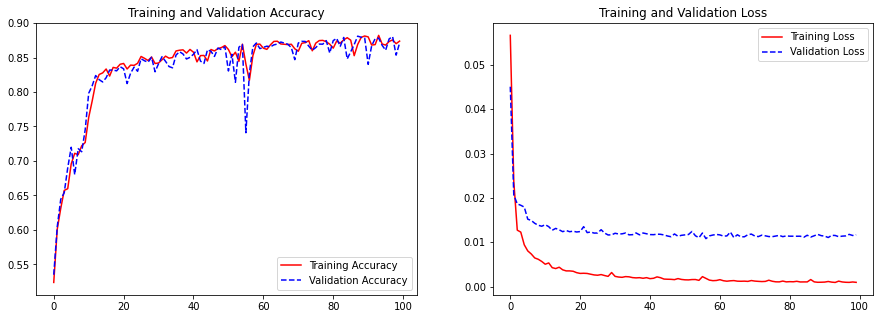

In [169]:
def plot_training(history):
    acc = history['accuracy']
    val_acc = history['val_accuracy']
    loss = history['loss']
    val_loss = history['val_loss']
    epochs = range(len(acc))

    fig, axes = plt.subplots(1, 2, figsize=(15,5))
    
    axes[0].plot(epochs, acc, 'r-', label='Training Accuracy')
    axes[0].plot(epochs, val_acc, 'b--', label='Validation Accuracy')
    axes[0].set_title('Training and Validation Accuracy')
    axes[0].legend(loc='best')

    axes[1].plot(epochs, loss, 'r-', label='Training Loss')
    axes[1].plot(epochs, val_loss, 'b--', label='Validation Loss')
    axes[1].set_title('Training and Validation Loss')
    axes[1].legend(loc='best')
    
    plt.show()

rem = model_line.history
plot_training(rem)

#Style Transfer with deep learning

In [181]:
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import numpy as np
import os
from keras import backend as K
from keras.preprocessing.image import load_img, save_img, img_to_array
import matplotlib.pyplot as plt
from keras.applications import vgg19
from keras.models import Model
#from keras import optimizers
from scipy.optimize import fmin_l_bfgs_b
#from keras.applications.vgg19 import VGG19
#vgg19_weights = '../input/vgg19/vgg19_weights_tf_dim_ordering_tf_kernels_notop.h5'
#vgg19 = VGG19(include_top = False, weights=vgg19_weights)
#print(os.listdir("../input"))

# Any results you write to the current directory are saved as output.

In [182]:
StylePath = '/content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data/images/images/'
ContentPath = '/content/drive/MyDrive/Photos/'

base_image_path = ContentPath+'EFFECTS.jpg'
style_image_path = StylePath+'Pablo_Picasso/Pablo_Picasso_92.jpg'
# dimensions of the generated picture.
width, height = load_img(base_image_path).size
img_nrows = 400
img_ncols = int(width * img_nrows / height)

In [183]:
def preprocess_image(image_path):
    from keras.applications import vgg19
    img = load_img(image_path, target_size=(img_nrows, img_ncols))
    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = vgg19.preprocess_input(img)
    return img

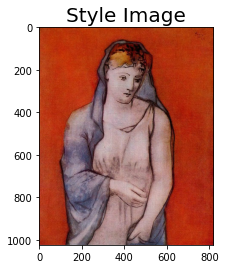

In [187]:
plt.figure()
plt.title("Style Image",fontsize=20)
img2 = load_img(StylePath+'Pablo_Picasso/Pablo_Picasso_9.jpg')
plt.imshow(img2)

In [341]:
import IPython.display as display

import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (12,12)
mpl.rcParams['axes.grid'] = False
import tensorflow as tf
import numpy as np
import PIL.Image
import time
import functools

In [189]:
def tensor_to_image(tensor):
  tensor = tensor*255
  tensor = np.array(tensor, dtype=np.uint8)
  if np.ndim(tensor)>3:
    assert tensor.shape[0] == 1
    tensor = tensor[0]
  return PIL.Image.fromarray(tensor)

In [345]:
style_path = '/content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data/images/images/Pablo_Picasso/Pablo_Picasso_250.jpg'
content_path = '/content/drive/MyDrive/Photos/mamon.jpg'

In [342]:
def load_img(path_to_img):
  max_dim = 512
  img = tf.io.read_file(path_to_img)
  img = tf.image.decode_image(img, channels=3)
  img = tf.image.convert_image_dtype(img, tf.float32)

  shape = tf.cast(tf.shape(img)[:-1], tf.float32)
  long_dim = max(shape)
  scale = max_dim / long_dim

  new_shape = tf.cast(shape * scale, tf.int32)

  img = tf.image.resize(img, new_shape)
  img = img[tf.newaxis, :]
  return img

In [343]:
def imshow(image, title=None):
  if len(image.shape) > 3:
    image = tf.squeeze(image, axis=0)

  plt.imshow(image)
  if title:
    plt.title(title)

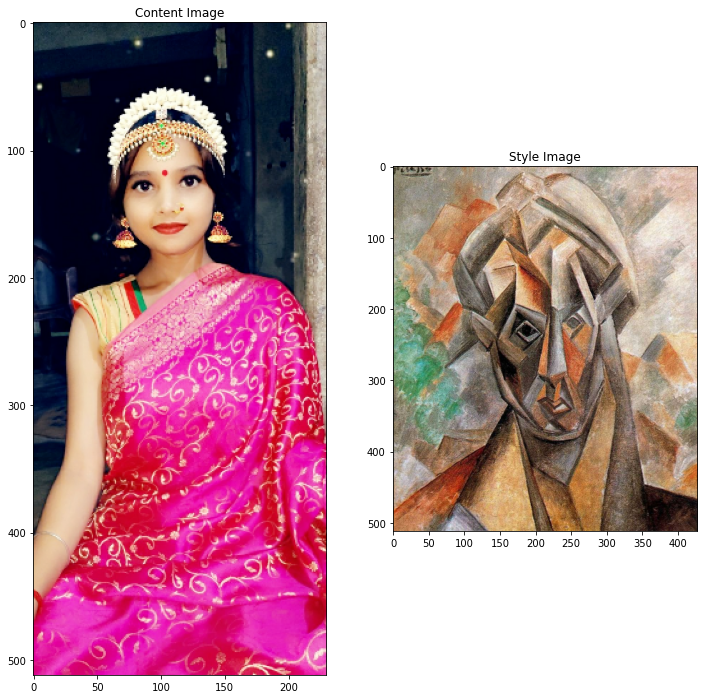

In [346]:
content_image = load_img(content_path)
style_image = load_img(style_path)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

In [195]:
x = tf.keras.applications.vgg19.preprocess_input(content_image*255)
x = tf.image.resize(x, (224, 224))
vgg = tf.keras.applications.VGG19(include_top=True, weights='imagenet')
prediction_probabilities = vgg(x)
prediction_probabilities.shape

574717952/574710816 [==============================] - 4s 0us/step


TensorShape([1, 1000])

In [196]:
import tensorflow_hub as hub
hub_model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')

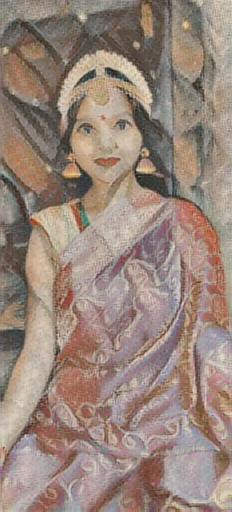

In [347]:
stylized_image = hub_model(tf.constant(content_image), tf.constant(style_image))[0]
tensor_to_image(stylized_image)

In [198]:
predicted_top_5 = tf.keras.applications.vgg19.decode_predictions(prediction_probabilities.numpy())[0]
[(class_name, prob) for (number, class_name, prob) in predicted_top_5]

40960/35363 [==================================] - 0s 0us/step


[('pajama', 0.18970676),
 ('gown', 0.13188423),
 ('stole', 0.100095026),
 ('poncho', 0.09241778),
 ('wig', 0.029658746)]

In [199]:
vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
"""print()
for layer in vgg.layers:
  print(layer.name)"""

80142336/80134624 [==============================] - 0s 0us/step


'print()\nfor layer in vgg.layers:\n  print(layer.name)'

In [200]:
content_layers = ['block5_conv2'] 

style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

In [201]:
def vgg_layers(layer_names):
  """ Creates a vgg model that returns a list of intermediate output values."""
  # Load our model. Load pretrained VGG, trained on imagenet data
  vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
  vgg.trainable = False

  outputs = [vgg.get_layer(name).output for name in layer_names]

  model = tf.keras.Model([vgg.input], outputs)
  return model

In [202]:
style_extractor = vgg_layers(style_layers)
style_outputs = style_extractor(style_image*255)

#Look at the statistics of each layer's output
for name, output in zip(style_layers, style_outputs):
  print(name)
  print("  shape: ", output.numpy().shape)
  print("  min: ", output.numpy().min())
  print("  max: ", output.numpy().max())
  print("  mean: ", output.numpy().mean())
  print()

block1_conv1
  shape:  (1, 512, 410, 64)
  min:  0.0
  max:  646.3685
  mean:  35.728798

block2_conv1
  shape:  (1, 256, 205, 128)
  min:  0.0
  max:  3255.1233
  mean:  147.00435

block3_conv1
  shape:  (1, 128, 102, 256)
  min:  0.0
  max:  6778.7295
  mean:  109.09215

block4_conv1
  shape:  (1, 64, 51, 512)
  min:  0.0
  max:  14523.033
  mean:  489.93192

block5_conv1
  shape:  (1, 32, 25, 512)
  min:  0.0
  max:  2085.8726
  mean:  36.310024



In [203]:
def gram_matrix(input_tensor):
  result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
  input_shape = tf.shape(input_tensor)
  num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
  return result/(num_locations)

In [204]:
class StyleContentModel(tf.keras.models.Model):
  def __init__(self, style_layers, content_layers):
    super(StyleContentModel, self).__init__()
    self.vgg =  vgg_layers(style_layers + content_layers)
    self.style_layers = style_layers
    self.content_layers = content_layers
    self.num_style_layers = len(style_layers)
    self.vgg.trainable = False

  def call(self, inputs):
    "Expects float input in [0,1]"
    inputs = inputs*255.0
    preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
    outputs = self.vgg(preprocessed_input)
    style_outputs, content_outputs = (outputs[:self.num_style_layers], 
                                      outputs[self.num_style_layers:])

    style_outputs = [gram_matrix(style_output)
                     for style_output in style_outputs]

    content_dict = {content_name:value 
                    for content_name, value 
                    in zip(self.content_layers, content_outputs)}

    style_dict = {style_name:value
                  for style_name, value
                  in zip(self.style_layers, style_outputs)}

    return {'content':content_dict, 'style':style_dict}

In [205]:
extractor = StyleContentModel(style_layers, content_layers)

results = extractor(tf.constant(content_image))

print('Styles:')
for name, output in sorted(results['style'].items()):
  print("  ", name)
  print("    shape: ", output.numpy().shape)
  print("    min: ", output.numpy().min())
  print("    max: ", output.numpy().max())
  print("    mean: ", output.numpy().mean())
  print()

print("Contents:")
for name, output in sorted(results['content'].items()):
  print("  ", name)
  print("    shape: ", output.numpy().shape)
  print("    min: ", output.numpy().min())
  print("    max: ", output.numpy().max())
  print("    mean: ", output.numpy().mean())

Styles:
   block1_conv1
    shape:  (1, 64, 64)
    min:  0.036916085
    max:  37439.652
    mean:  1655.4475

   block2_conv1
    shape:  (1, 128, 128)
    min:  0.0
    max:  399959.47
    mean:  42087.418

   block3_conv1
    shape:  (1, 256, 256)
    min:  12.141238
    max:  1257265.6
    mean:  44732.67

   block4_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  39453256.0
    mean:  516784.75

   block5_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  240267.78
    mean:  3629.2437

Contents:
   block5_conv2
    shape:  (1, 32, 14, 512)
    min:  0.0
    max:  2297.749
    mean:  24.100742


In [206]:
style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']

In [207]:
image = tf.Variable(content_image)

In [208]:
def clip_0_1(image):
  return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

In [209]:
opt = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)
style_weight=1e-2
content_weight=1e4

In [210]:
def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    return loss

In [215]:
@tf.function()
def train_step(image):
  with tf.GradientTape() as tape:
    outputs = extractor(image)
    loss = style_content_loss(outputs)

  grad = tape.gradient(loss, image)
  opt.apply_gradients([(grad, image)])
  image.assign(clip_0_1(image))

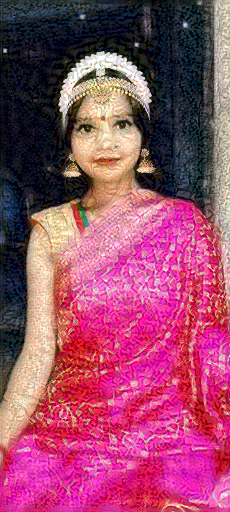

In [218]:
train_step(image)
train_step(image)
train_step(image)
tensor_to_image(image)

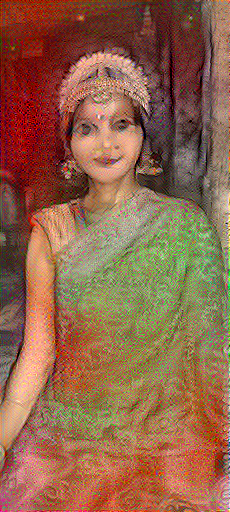

Train step: 1000
Total time: 45.2


In [219]:
import time
start = time.time()

epochs = 10
steps_per_epoch = 100

step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    train_step(image)
    print(".", end='')
  display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  print("Train step: {}".format(step))

end = time.time()
print("Total time: {:.1f}".format(end-start))

In [ ]:
def high_pass_x_y(image):
  x_var = image[:,:,1:,:] - image[:,:,:-1,:]
  y_var = image[:,1:,:,:] - image[:,:-1,:,:]

  return x_var, y_var

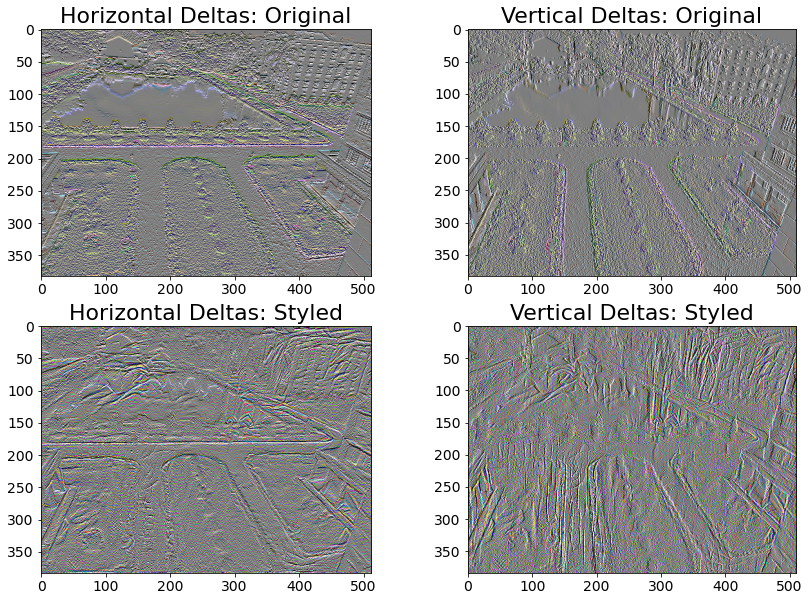

In [ ]:
x_deltas, y_deltas = high_pass_x_y(content_image)

plt.figure(figsize=(14,10))
plt.subplot(2,2,1)
imshow(clip_0_1(2*y_deltas+0.5), "Horizontal Deltas: Original")

plt.subplot(2,2,2)
imshow(clip_0_1(2*x_deltas+0.5), "Vertical Deltas: Original")

x_deltas, y_deltas = high_pass_x_y(image)

plt.subplot(2,2,3)
imshow(clip_0_1(2*y_deltas+0.5), "Horizontal Deltas: Styled")

plt.subplot(2,2,4)
imshow(clip_0_1(2*x_deltas+0.5), "Vertical Deltas: Styled")

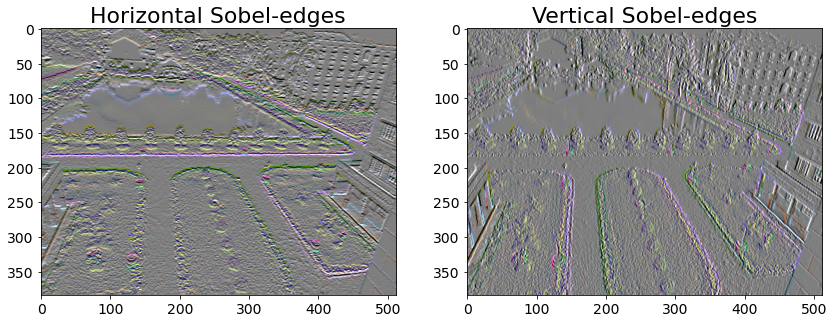

In [ ]:
plt.figure(figsize=(14,10))

sobel = tf.image.sobel_edges(content_image)
plt.subplot(1,2,1)
imshow(clip_0_1(sobel[...,0]/4+0.5), "Horizontal Sobel-edges")
plt.subplot(1,2,2)
imshow(clip_0_1(sobel[...,1]/4+0.5), "Vertical Sobel-edges")

In [ ]:
def total_variation_loss(image):
  x_deltas, y_deltas = high_pass_x_y(image)
  return tf.reduce_sum(tf.abs(x_deltas)) + tf.reduce_sum(tf.abs(y_deltas))

In [ ]:
total_variation_loss(image).numpy()

156107.94

In [ ]:
tf.image.total_variation(image).numpy()

array([156107.94], dtype=float32)

In [ ]:
total_variation_weight=30


@tf.function()
def train_step(image):
  with tf.GradientTape() as tape:
    outputs = extractor(image)
    loss = style_content_loss(outputs)
    loss += total_variation_weight*tf.image.total_variation(image)

  grad = tape.gradient(loss, image)
  opt.apply_gradients([(grad, image)])
  image.assign(clip_0_1(image))

In [ ]:
image = tf.Variable(content_image)

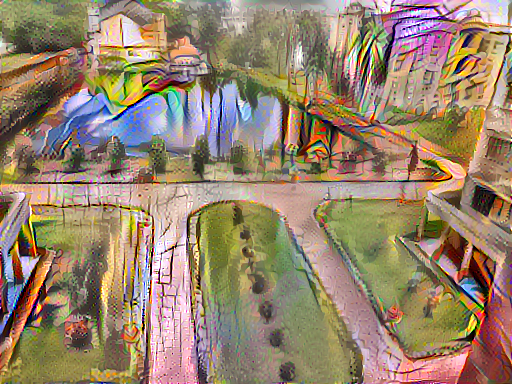

Train step: 1000
Total time: 69.1


In [ ]:
import time
start = time.time()

epochs = 10
steps_per_epoch = 100

step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    train_step(image)
    print(".", end='')
  display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  print("Train step: {}".format(step))

end = time.time()
print("Total time: {:.1f}".format(end-start))

In [ ]:
file_name = 'stylized-image.png'
tensor_to_image(image).save(file_name)

try:
  from google.colab import files
except ImportError:
   pass
else:
  files.download(file_name)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

"plt.subplot(1, 2, 2)\nimshow(style_image, 'Style Image')"

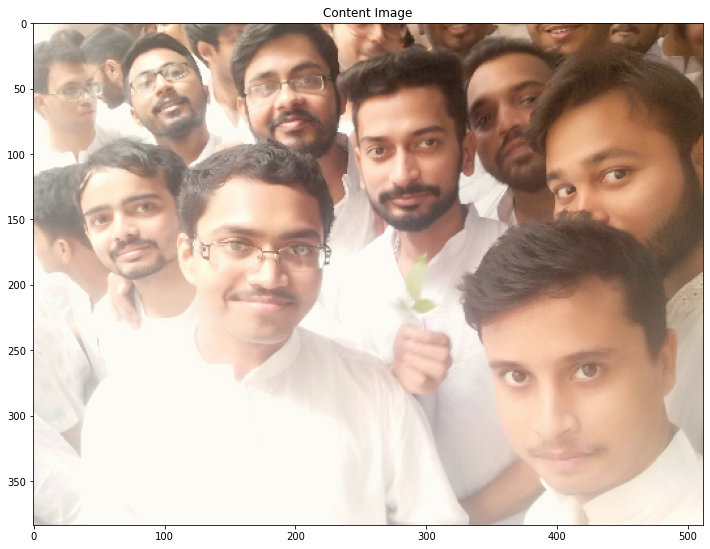

In [315]:
content_image = load_img(content_path)
style_image = load_img(style_path)

"""plt.subplot(1, 2, 1)"""
imshow(content_image, 'Content Image')
"""plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')"""

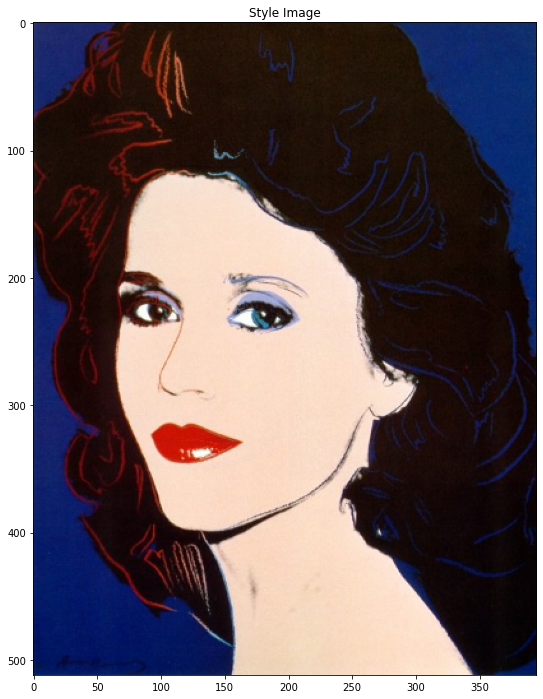

In [338]:
imshow(style_image, 'Style Image')

In [335]:
style_path = '/content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data/images/images/Andy_Warhol/Andy_Warhol_44.jpg'
content_path = '/content/drive/MyDrive/Photos/groupfie.jpg'
style_weight=1e-2
content_weight=500

StylePath = '/content/drive/MyDrive/Subhasish_Roy_Dataset/ml_data/images/images/'
ContentPath = '/content/drive/MyDrive/Photos/'


base_image_path = content_path
style_image_path = style_path

#Ready

In [336]:
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import numpy as np
import os
from keras import backend as K
from keras.preprocessing.image import load_img, save_img, img_to_array
import matplotlib.pyplot as plt
from keras.applications import vgg19
from keras.models import Model
#from keras import optimizers
from scipy.optimize import fmin_l_bfgs_b
#from keras.applications.vgg19 import VGG19
#vgg19_weights = '../input/vgg19/vgg19_weights_tf_dim_ordering_tf_kernels_notop.h5'
#vgg19 = VGG19(include_top = False, weights=vgg19_weights)
#print(os.listdir("../input"))
import IPython.display as display

import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (12,12)
mpl.rcParams['axes.grid'] = False
import tensorflow as tf
import numpy as np
import PIL.Image
import time
import functools
# Any results you write to the current directory are saved as output.






# dimensions of the generated picture.
width, height = load_img(base_image_path).size
img_nrows = 400
img_ncols = int(width * img_nrows / height)


def preprocess_image(image_path):
    from keras.applications import vgg19
    img = load_img(image_path, target_size=(img_nrows, img_ncols))
    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = vgg19.preprocess_input(img)
    return img


def tensor_to_image(tensor):
  tensor = tensor*255
  tensor = np.array(tensor, dtype=np.uint8)
  if np.ndim(tensor)>3:
    assert tensor.shape[0] == 1
    tensor = tensor[0]
  return PIL.Image.fromarray(tensor)



def load_img(path_to_img):
  max_dim = 512
  img = tf.io.read_file(path_to_img)
  img = tf.image.decode_image(img, channels=3)
  img = tf.image.convert_image_dtype(img, tf.float32)

  shape = tf.cast(tf.shape(img)[:-1], tf.float32)
  long_dim = max(shape)
  scale = max_dim / long_dim

  new_shape = tf.cast(shape * scale, tf.int32)

  img = tf.image.resize(img, new_shape)
  img = img[tf.newaxis, :]
  return img




def imshow(image, title=None):
  if len(image.shape) > 3:
    image = tf.squeeze(image, axis=0)

  plt.imshow(image)
  if title:
    plt.title(title)



content_image = load_img(content_path)
style_image = load_img(style_path)



x = tf.keras.applications.vgg19.preprocess_input(content_image*255)
x = tf.image.resize(x, (224, 224))
vgg = tf.keras.applications.VGG19(include_top=True, weights='imagenet')
prediction_probabilities = vgg(x)
prediction_probabilities.shape

content_layers = ['block5_conv2'] 

style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)


def vgg_layers(layer_names):
  """ Creates a vgg model that returns a list of intermediate output values."""
  # Load our model. Load pretrained VGG, trained on imagenet data
  vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
  vgg.trainable = False

  outputs = [vgg.get_layer(name).output for name in layer_names]

  model = tf.keras.Model([vgg.input], outputs)
  return model



style_extractor = vgg_layers(style_layers)
style_outputs = style_extractor(style_image*255)

def gram_matrix(input_tensor):
  result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
  input_shape = tf.shape(input_tensor)
  num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
  return result/(num_locations)



class StyleContentModel(tf.keras.models.Model):
  def __init__(self, style_layers, content_layers):
    super(StyleContentModel, self).__init__()
    self.vgg =  vgg_layers(style_layers + content_layers)
    self.style_layers = style_layers
    self.content_layers = content_layers
    self.num_style_layers = len(style_layers)
    self.vgg.trainable = False

  def call(self, inputs):
    "Expects float input in [0,1]"
    inputs = inputs*255.0
    preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
    outputs = self.vgg(preprocessed_input)
    style_outputs, content_outputs = (outputs[:self.num_style_layers], 
                                      outputs[self.num_style_layers:])

    style_outputs = [gram_matrix(style_output)
                     for style_output in style_outputs]

    content_dict = {content_name:value 
                    for content_name, value 
                    in zip(self.content_layers, content_outputs)}

    style_dict = {style_name:value
                  for style_name, value
                  in zip(self.style_layers, style_outputs)}

    return {'content':content_dict, 'style':style_dict}


extractor = StyleContentModel(style_layers, content_layers)

results = extractor(tf.constant(content_image))



style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']
image = tf.Variable(content_image)

def clip_0_1(image):
  return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

opt = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)


def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    return loss


@tf.function()
def train_step(image):
  with tf.GradientTape() as tape:
    outputs = extractor(image)
    loss = style_content_loss(outputs)

  grad = tape.gradient(loss, image)
  opt.apply_gradients([(grad, image)])
  image.assign(clip_0_1(image))












#set

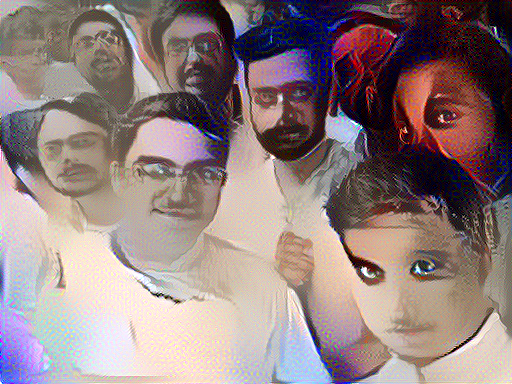

Train step: 1000
Total time: 73.0


In [337]:
import time
start = time.time()

epochs = 10
steps_per_epoch = 100

step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    train_step(image)
    print(".", end='')
  display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  print("Train step: {}".format(step))

end = time.time()
print("Total time: {:.1f}".format(end-start))

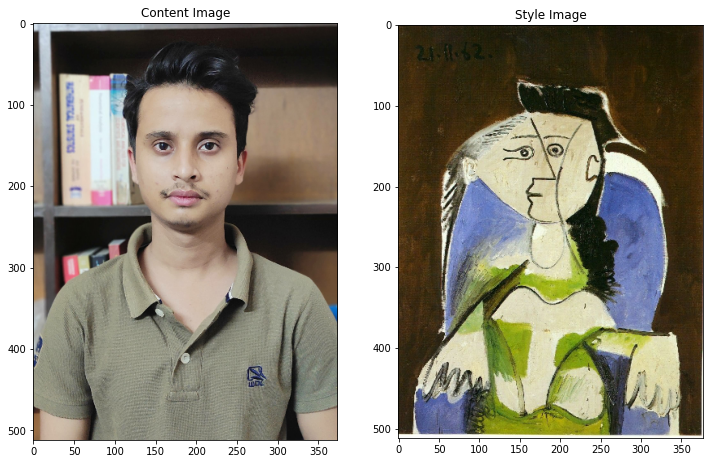

In [261]:
content_image = load_img(content_path)
style_image = load_img(style_path)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

# Deep dream 

In [31]:
def load_img(path_to_img):
  max_dim = 500
  img = tf.io.read_file(path_to_img)
  img = tf.image.decode_image(img, channels=3)
  img = tf.image.convert_image_dtype(img, tf.float32)

  shape = tf.cast(tf.shape(img)[:-1], tf.float32)
  long_dim = max(shape)
  scale = max_dim / long_dim

  new_shape = tf.cast(shape * scale, tf.int32)

  img = tf.image.resize(img, new_shape)
  img = img[tf.newaxis, :]
  return img

In [32]:
import numpy as np
import IPython.display as display
import PIL.Image

from tensorflow.keras.preprocessing import image
# Download an image and read it into a NumPy array.
img = plt.imread('/content/drive/MyDrive/Photos/IMG_20200510_074004_071.jpg')
original_img = np.array(img)
# Normalize an image
def deprocess(img):
  img = 255*(img + 1.0)/2.0
  return tf.cast(img, tf.uint8)

# Display an image
def show(img):
  display.display(PIL.Image.fromarray(np.array(img)))

#show(img)
#img.shape

In [33]:
base_model = tf.keras.applications.InceptionV3(include_top=False, weights='imagenet')

In [34]:
# Download an image and read it into a NumPy array.
def download(url, max_dim=None):
  name = url.split('/')[-1]
  image_path = tf.keras.utils.get_file(name, origin=url)
  img = PIL.Image.open(image_path)
  if max_dim:
    img.thumbnail((max_dim, max_dim))
  return np.array(img)

# Normalize an image
def deprocess(img):
  img = 255*(img + 1.0)/2.0
  return tf.cast(img, tf.uint8)

# Display an image
def show(img):
  display.display(PIL.Image.fromarray(np.array(img)))


"""# Downsizing the image makes it easier to work with.
original_img = download(url, max_dim=500)
show(original_img)
display.display(display.HTML('Image cc-by: <a "href=https://commons.wikimedia.org/wiki/File:Felis_catus-cat_on_snow.jpg">Von.grzanka</a>'))"""

'# Downsizing the image makes it easier to work with.\noriginal_img = download(url, max_dim=500)\nshow(original_img)\ndisplay.display(display.HTML(\'Image cc-by: <a "href=https://commons.wikimedia.org/wiki/File:Felis_catus-cat_on_snow.jpg">Von.grzanka</a>\'))'

In [35]:
# Maximize the activations of these layers
names = ['mixed3', 'mixed5']
layers = [base_model.get_layer(name).output for name in names]

# Create the feature extraction model
dream_model = tf.keras.Model(inputs=base_model.input, outputs=layers)

In [36]:
def calc_loss(img, model):
  # Pass forward the image through the model to retrieve the activations.
  # Converts the image into a batch of size 1.
  img_batch = tf.expand_dims(img, axis=0)
  layer_activations = model(img_batch)
  if len(layer_activations) == 1:
    layer_activations = [layer_activations]

  losses = []
  for act in layer_activations:
    loss = tf.math.reduce_mean(act)
    losses.append(loss)

  return  tf.reduce_sum(losses)

In [37]:
class DeepDream(tf.Module):
  def __init__(self, model):
    self.model = model

  @tf.function(
      input_signature=(
        tf.TensorSpec(shape=[None,None,3], dtype=tf.float32),
        tf.TensorSpec(shape=[], dtype=tf.int32),
        tf.TensorSpec(shape=[], dtype=tf.float32),)
  )
  def __call__(self, img, steps, step_size):
      print("Tracing")
      loss = tf.constant(0.0)
      for n in tf.range(steps):
        with tf.GradientTape() as tape:
          # This needs gradients relative to `img`
          # `GradientTape` only watches `tf.Variable`s by default
          tape.watch(img)
          loss = calc_loss(img, self.model)

        # Calculate the gradient of the loss with respect to the pixels of the input image.
        gradients = tape.gradient(loss, img)

        # Normalize the gradients.
        gradients /= tf.math.reduce_std(gradients) + 1e-8 

        # In gradient ascent, the "loss" is maximized so that the input image increasingly "excites" the layers.
        # You can update the image by directly adding the gradients (because they're the same shape!)
        img = img + gradients*step_size
        img = tf.clip_by_value(img, -1, 1)

      return loss, img

In [38]:
deepdream = DeepDream(dream_model)

In [40]:
def run_deep_dream_simple(img, steps=1000, step_size=0.01):
  # Convert from uint8 to the range expected by the model.
  img = tf.keras.applications.inception_v3.preprocess_input(img)
  img = tf.convert_to_tensor(img)
  step_size = tf.convert_to_tensor(step_size)
  steps_remaining = steps
  step = 0
  while steps_remaining:
    if steps_remaining>100:
      run_steps = tf.constant(100)
    else:
      run_steps = tf.constant(steps_remaining)
    steps_remaining -= run_steps
    step += run_steps

    loss, img = deepdream(img, run_steps, tf.constant(step_size))

    display.clear_output(wait=True)
    show(deprocess(img))
    print ("Step {}, loss {}".format(step, loss))


  result = deprocess(img)
  display.clear_output(wait=True)
  show(result)

  return result

In [41]:
dream_img = run_deep_dream_simple(img=img, 
                                  steps=1000, step_size=0.01)

Tracing


KeyboardInterrupt: ignored

In [11]:
# Maximize the activations of these layers
names = ['mixed3', 'mixed5']
layers = [base_model.get_layer(name).output for name in names]

# Create the feature extraction model
dream_model = tf.keras.Model(inputs=base_model.input, outputs=layers)
#base_model.summary()

In [12]:
def calc_loss(img, model):
  # Pass forward the image through the model to retrieve the activations.
  # Converts the image into a batch of size 1.
  img_batch = tf.expand_dims(img, axis=0)
  layer_activations = model(img_batch)
  if len(layer_activations) == 1:
    layer_activations = [layer_activations]

  losses = []
  for act in layer_activations:
    loss = tf.math.reduce_mean(act)
    losses.append(loss)

  return  tf.reduce_sum(losses)

In [13]:
class DeepDream(tf.Module):
  def __init__(self, model):
    self.model = model

  @tf.function(
      input_signature=(
        tf.TensorSpec(shape=[None,None,3], dtype=tf.float32),
        tf.TensorSpec(shape=[], dtype=tf.int32),
        tf.TensorSpec(shape=[], dtype=tf.float32),)
  )
  def __call__(self, img, steps, step_size):
      print("Tracing")
      loss = tf.constant(0.0)
      for n in tf.range(steps):
        with tf.GradientTape() as tape:
          # This needs gradients relative to `img`
          # `GradientTape` only watches `tf.Variable`s by default
          tape.watch(img)
          loss = calc_loss(img, self.model)

        # Calculate the gradient of the loss with respect to the pixels of the input image.
        gradients = tape.gradient(loss, img)

        # Normalize the gradients.
        gradients /= tf.math.reduce_std(gradients) + 1e-8 
        
        # In gradient ascent, the "loss" is maximized so that the input image increasingly "excites" the layers.
        # You can update the image by directly adding the gradients (because they're the same shape!)
        img = img + gradients*step_size
        img = tf.clip_by_value(img, -1, 1)

      return loss, img

deepdream = DeepDream(dream_model)

In [14]:
def run_deep_dream_simple(img, steps=100, step_size=0.01):
  # Convert from uint8 to the range expected by the model.
  img = tf.keras.applications.inception_v3.preprocess_input(img)
  img = tf.convert_to_tensor(img)
  step_size = tf.convert_to_tensor(step_size)
  steps_remaining = steps
  step = 0
  while steps_remaining:
    if steps_remaining>100:
      run_steps = tf.constant(100)
    else:
      run_steps = tf.constant(steps_remaining)
    steps_remaining -= run_steps
    step += run_steps

    loss, img = deepdream(img, run_steps, tf.constant(step_size))
    
    display.clear_output(wait=True)
    show(deprocess(img))
    print ("Step {}, loss {}".format(step, loss))


  result = deprocess(img)
  display.clear_output(wait=True)
  show(result)

  return result

In [ ]:
dream_img = run_deep_dream_simple(img=original_img, steps=100, step_size=0.01)

Tracing


# Deep dream 2

In [43]:
!apt install -y caffe-cpu
# imports and basic notebook setup
#from cStringIO import StringIO
from io import StringIO
import numpy as np
import scipy.ndimage as nd
import PIL.Image
from IPython.display import clear_output, Image, display
from google.protobuf import text_format

import caffe
from io import BytesIO
#buffer = BytesIO()


# If your GPU supports CUDA and Caffe was built with CUDA support,
# uncomment the following to run Caffe operations on the GPU.
caffe.set_mode_gpu()
# caffe.set_device(0) # select GPU device if multiple devices exist

def showarray(a, fmt='jpeg'):
    a = np.uint8(np.clip(a, 0, 255))
    f = StringIO()
    #buffer.write(open(a,'rb').read())
    PIL.Image.fromarray(a).save(f, fmt)
    display(Image(data=f.getvalue()))

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'apt autoremove' to remove it.
The following additional packages will be installed:
  caffe-tools-cpu cython3 fonts-lyx javascript-common libblosc1 libcaffe-cpu1
  libgflags2.2 libgoogle-glog0v5 libjs-jquery libjs-jquery-ui libleveldb1v5
  liblmdb0 python-matplotlib-data python-tables-data python3-bs4
  python3-caffe-cpu python3-chardet python3-cycler python3-dateutil
  python3-decorator python3-gflags python3-h5py python3-html5lib
  python3-ipython python3-ipython-genutils python3-leveldb python3-lxml
  python3-matplotlib python3-networkx python3-nose python3-numexpr
  python3-numpy python3-olefile python3-pandas python3-pandas-lib
  python3-pexpect python3-pickleshare python3-pil python3-pkg-resources
  python3-prompt-toolkit python3-protobuf python3-ptyprocess python3-pygments
  python3

ModuleNotFoundError: ignored

In [ ]:
#!git clone https://github.com/kesara/deepdreamer.git
#%cd deepdreamer/
!ls

[Errno 2] No such file or directory: 'deepdreamer/'
/content/deepdreamer/deepdreamer
deepdreamer.py	deploy.prototxt  images2gif.py	__init__.py


In [ ]:
#!cp "/content/drive/MyDrive/caffe-master/caffe-master/models/bvlc_googlenet/deploy.prototxt" "/content/deepdreamer/deepdreamer/"
!cp "/content/drive/MyDrive/caffe-master/caffe-master/models/bvlc_googlenet/bvlc_googlenet.caffemodel" "/content/deepdreamer/deepdreamer/"

In [ ]:
#model_path = '/content/drive/MyDrive/caffe-master/caffe-master/models/bvlc_googlenet/' 

net_fn   =  'deploy.prototxt'
param_fn =  'bvlc_googlenet.caffemodel'

# Patching model to be able to compute gradients.
# Note that you can also manually add "force_backward: true" line to "deploy.prototxt".
model = caffe.io.caffe_pb2.NetParameter()
text_format.Merge(open(net_fn).read(), model)
model.force_backward = True
open('tmp.prototxt', 'w').write(str(model))

net = caffe.Classifier('tmp.prototxt', param_fn,
                       mean = np.float32([104.0, 116.0, 122.0]), # ImageNet mean, training set dependent
                       channel_swap = (2,1,0)) # the reference model has channels in BGR order instead of RGB

# a couple of utility functions for converting to and from Caffe's input image layout
def preprocess(net, img):
    return np.float32(np.rollaxis(img, 2)[::-1]) - net.transformer.mean['data']
def deprocess(net, img):
    return np.dstack((img + net.transformer.mean['data'])[::-1])

In [ ]:
def objective_L2(dst):
    dst.diff[:] = dst.data 

def make_step(net, step_size=1.5, end='inception_4c/output', 
              jitter=32, clip=True, objective=objective_L2):
    '''Basic gradient ascent step.'''

    src = net.blobs['data'] # input image is stored in Net's 'data' blob
    dst = net.blobs[end]

    ox, oy = np.random.randint(-jitter, jitter+1, 2)
    src.data[0] = np.roll(np.roll(src.data[0], ox, -1), oy, -2) # apply jitter shift
            
    net.forward(end=end)
    objective(dst)  # specify the optimization objective
    net.backward(start=end)
    g = src.diff[0]
    # apply normalized ascent step to the input image
    src.data[:] += step_size/np.abs(g).mean() * g

    src.data[0] = np.roll(np.roll(src.data[0], -ox, -1), -oy, -2) # unshift image
            
    if clip:
        bias = net.transformer.mean['data']
        src.data[:] = np.clip(src.data, -bias, 255-bias)


In [ ]:
def deepdream(net, base_img, iter_n=10, octave_n=4, octave_scale=1.4, 
              end='inception_4c/output', clip=True, **step_params):
    # prepare base images for all octaves
    octaves = [preprocess(net, base_img)]
    for i in range(octave_n-1):
        octaves.append(nd.zoom(octaves[-1], (1, 1.0/octave_scale,1.0/octave_scale), order=1))
    
    src = net.blobs['data']
    detail = np.zeros_like(octaves[-1]) # allocate image for network-produced details
    for octave, octave_base in enumerate(octaves[::-1]):
        h, w = octave_base.shape[-2:]
        if octave > 0:
            # upscale details from the previous octave
            h1, w1 = detail.shape[-2:]
            detail = nd.zoom(detail, (1, 1.0*h/h1,1.0*w/w1), order=1)

        src.reshape(1,3,h,w) # resize the network's input image size
        src.data[0] = octave_base+detail
        for i in range(iter_n):
            make_step(net, end=end, clip=clip, **step_params)
            
            # visualization
            vis = deprocess(net, src.data[0])
            if not clip: # adjust image contrast if clipping is disabled
                vis = vis*(255.0/np.percentile(vis, 99.98))
            showarray(vis)
            print(octave, i, end, vis.shape)
            clear_output(wait=True)
            
        # extract details produced on the current octave
        detail = src.data[0]-octave_base
    # returning the resulting image
    return deprocess(net, src.data[0])

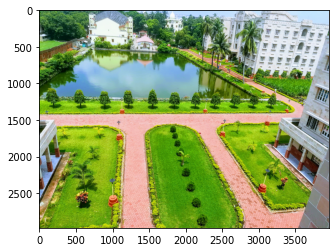

In [ ]:
import matplotlib.pyplot as plt
img = plt.imread('/content/drive/MyDrive/Photos/EFFECTS.jpg')
plt.imshow(img)

In [ ]:
_ = deepdream(net, img)

#Model 1

In [ ]:
# get tensor representations of our images

base_image = K.variable(preprocess_image(base_image_path))
style_reference_image = K.variable(preprocess_image(style_image_path))

K.image_data_format()


In [ ]:
# this will contain our generated image
if K.image_data_format() == 'channels_first':
    combination_image = K.placeholder((1,3,img_nrows, img_ncols))
else:
    combination_image = K.placeholder((1,img_nrows, img_ncols,3))

In [ ]:
# combine the 3 images into a single Keras tensor
input_tensor = K.concatenate([base_image,
                              style_reference_image,
                              combination_image
                              ], axis=0)

In [ ]:
# build the VGG19 network with our 3 images as input
# the model will be loaded with pre-trained ImageNet weights
from keras.applications.vgg19 import VGG19
vgg19_weights = '../input/vgg19/vgg19_weights_tf_dim_ordering_tf_kernels_notop.h5'
#model = VGG19(input_tensor=input_tensor, include_top = False, weights=vgg19_weights)
model = vgg19.VGG19(input_tensor=input_tensor,
                    weights='imagenet', include_top=False)
print('Model loaded.')

Athough Vgg19 is basically used for Classification purpose, but here our objective is not to classify rather our objective is to transform a image, so we do not need all the layers of vgg19, we have specially excluded those layers which are used for classification.

In [ ]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv2'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1',
                'block5_conv1'
               ]

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

In [ ]:
outputs_dict = dict([(layer.name, layer.output) for layer in model.layers])
print(outputs_dict['block5_conv2'])

In [ ]:
# an auxiliary loss function
# designed to maintain the "content" of the
# base image in the generated image
def get_content_loss(base_content, target):
    return K.sum(K.square(target - base_content))

In [ ]:
import tensorflow as tf
# the gram matrix of an image tensor (feature-wise outer product)
def gram_matrix(input_tensor):
    assert K.ndim(input_tensor)==3
    #if K.image_data_format() == 'channels_first':
    #    features = K.batch_flatten(input_tensor)
    #else:
    #    features = K.batch_flatten(K.permute_dimensions(input_tensor,(2,0,1)))
    #gram = K.dot(features, K.transpose(features))
    channels = int(input_tensor.shape[-1])
    a = tf.reshape(input_tensor, [-1, channels])
    n = tf.shape(a)[0]
    gram = tf.matmul(a, a, transpose_a=True)
    return gram#/tf.cast(n, tf.float32)

def get_style_loss(style, combination):
    assert K.ndim(style) == 3
    assert K.ndim(combination) == 3
    S = gram_matrix(style)
    C = gram_matrix(combination)
    channels = 3
    size = img_nrows*img_ncols
    return K.sum(K.square(S - C))#/(4.0 * (channels ** 2) * (size ** 2))
    

In [ ]:
content_weight=0.025 
style_weight=1.0
# combine these loss functions into a single scalar
loss = K.variable(0.0)
layer_features = outputs_dict['block5_conv2']
base_image_features = layer_features[0, :, :, :]
combination_features = layer_features[2, :, :, :]
print('Layer Feature for Content Layers :: '+str(layer_features))
print('Base Image Feature :: '+str(base_image_features))
print('Combination Image Feature for Content Layers:: '+str(combination_features)+'\n')
loss = loss + content_weight * get_content_loss(base_image_features, combination_features)

feature_layers = ['block1_conv1', 'block2_conv1',
                  'block3_conv1', 'block4_conv1',
                  'block5_conv1']
for layer_name in feature_layers:
    layer_features = outputs_dict[layer_name]
    style_reference_features = layer_features[1, :, :, :]
    combination_features = layer_features[2, :, :, :]
    print('Layer Feature for Style Layers :: '+str(layer_features))
    print('Style Image Feature :: '+str(style_reference_features))
    print('Combination Image Feature for Style Layers:: '+str(combination_features)+'\n')
    sl = get_style_loss(style_reference_features, combination_features)
    loss += (style_weight / len(feature_layers)) * sl

In [ ]:
def deprocess_image(x):
    if K.image_data_format() == 'channels_first':
        x = x.reshape((3, img_nrows, img_ncols))
        x = x.transpose((1, 2, 0))
    else:
        x = x.reshape((img_nrows, img_ncols, 3))
    # Remove zero-center by mean pixel
    x[:, :, 0] += 103.939
    x[:, :, 1] += 116.779
    x[:, :, 2] += 123.68
    # 'BGR'->'RGB'
    x = x[:, :, ::-1]
    x = np.clip(x, 0, 255).astype('uint8')
    return x

In [ ]:
# get the gradients of the generated image wrt the loss
grads = K.gradients(loss, combination_image)
grads

In [ ]:
outputs = [loss]
if isinstance(grads, (list,tuple)):
    outputs += grads
else:
    outputs.append(grads)
f_outputs = k.function([combination_image], outputs)
f_outputs

In [ ]:
# run scipy-based optimization (L-BFGS) over the pixels of the generated image
# so as to minimize the neural style loss
x_opt = preprocess_image(base_image_path)

In [ ]:
def eval_loss_and_grads(x):
    if K.image_data_format() == 'channels_first':
        x = x.reshape((1, 3, img_nrows, img_ncols))
    else:
        x = x.reshape((1, img_nrows, img_ncols, 3))
    outs = f_outputs([x])
    loss_value = outs[0]
    if len(outs[1:]) == 1:
        grad_values = outs[1].flatten().astype('float64')
    else:
        grad_values = np.array(outs[1:]).flatten().astype('float64')
    return loss_value, grad_values

In [ ]:
class Evaluator(object):

    def __init__(self):
        self.loss_value = None
        self.grads_values = None

    def loss(self, x):
        assert self.loss_value is None
        loss_value, grad_values = eval_loss_and_grads(x)
        self.loss_value = loss_value
        self.grad_values = grad_values
        return self.loss_value

    def grads(self, x):
        assert self.loss_value is not None
        grad_values = np.copy(self.grad_values)
        self.loss_value = None
        self.grad_values = None
        return grad_values
evaluator = Evaluator()

In [ ]:
iterations=400
# Store our best result
best_loss, best_img = float('inf'), None
for i in range(iterations):
    print('Start of iteration', i)
    x_opt, min_val, info= fmin_l_bfgs_b(evaluator.loss, 
                                        x_opt.flatten(), 
                                        fprime=evaluator.grads,
                                        maxfun=20,
                                        disp=True,
                                       )
    print('Current loss value:', min_val)
    if min_val < best_loss:
        # Update best loss and best image from total loss. 
        best_loss = min_val
        best_img = x_opt.copy()

In [ ]:
# save current generated image
imgx = deprocess_image(best_img.copy())
plt.imshow(imgx)

In [ ]:
plt.figure(figsize=(30,30))
plt.subplot(5,5,1)
plt.title("Base Image",fontsize=20)
img_base = load_img(base_image_path)
plt.imshow(img_base)

plt.subplot(5,5,1+1)
plt.title("Style Image",fontsize=20)
img_style = load_img(style_image_path)
plt.imshow(img_style)

plt.subplot(5,5,1+2)
plt.title("Final Image",fontsize=20)
plt.imshow(imgx)

In [ ]:
def preprocess_image_instantiator(image_path,img_nrows,img_ncols):
    from keras.applications import vgg19
    img = load_img(image_path, target_size=(img_nrows, img_ncols))
    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = vgg19.preprocess_input(img)
    return img

In [ ]:
base_image_path_1 = '../input/image-classification/images/images/travel and  adventure/Places365_val_00005821.jpg'
plt.figure(figsize=(30,30))
plt.subplot(5,5,1)
plt.title("Base Image",fontsize=20)
img_base = load_img(base_image_path_1)
plt.imshow(img_base)

style_image_path_1 = '../input/best-artworks-of-all-time/images/images/Paul_Klee/Paul_Klee_96.jpg'
plt.subplot(5,5,1+1)
plt.title("Style Image",fontsize=20)
img_style = load_img(style_image_path_1)
plt.imshow(img_style)

plt.subplot(5,5,1+2)
imgg = Run_StyleTransfer(base_image_path_1, style_image_path_1)
plt.title("Final Image",fontsize=20)
plt.imshow(imgg)

In [ ]:
base_image_path_2 = '../input/image-classification/images/images/travel and  adventure/Places365_val_00005982.jpg'
plt.figure(figsize=(30,30))
plt.subplot(5,5,1)
plt.title("Base Image",fontsize=20)
img_base = load_img(base_image_path_2)
plt.imshow(img_base)

style_image_path_2 = '../input/best-artworks-of-all-time/images/images/Paul_Klee/Paul_Klee_24.jpg'
plt.subplot(5,5,1+1)
plt.title("Style Image",fontsize=20)
img_style = load_img(style_image_path_2)
plt.imshow(img_style)

plt.subplot(5,5,1+2)
imga = Run_StyleTransfer(base_image_path_2, style_image_path_2)
plt.title("Final Image",fontsize=20)
plt.imshow(imga)

In [ ]:
base_image_path_3 = '../input/image-classification/images/images/travel and  adventure/Places365_val_00005752.jpg'
plt.figure(figsize=(30,30))
plt.subplot(5,5,1)
plt.title("Base Image",fontsize=20)
img_base = load_img(base_image_path_3)
plt.imshow(img_base)

style_image_path_3 = '../input/best-artworks-of-all-time/images/images/Paul_Klee/Paul_Klee_83.jpg'
plt.subplot(5,5,1+1)
plt.title("Style Image",fontsize=20)
img_style = load_img(style_image_path_3)
plt.imshow(img_style)

plt.subplot(5,5,1+2)
imgy = Run_StyleTransfer(base_image_path_3, style_image_path_3)
plt.title("Final Image",fontsize=20)
plt.imshow(imgy)